# Analysis of LINET lightning dataset

**Author**: Petar Sarajcev, PhD (petar.sarajcev@fesb.hr)

University of Split, FESB, Department of Power Engineering,
R. Boskovica 32, HR-21000 Split, Croatia, EU.

A dataset of lightning information for a particular region of cca 400 km2 of Croatian mainland, for a calendar year of 2014, has been obtained from the German company **nowcast GmbH** https://www.nowcast.de/en.html (which operates the European LINET lightning detection network). This dataset is proprietary and has been obtained for the research purposes only. It can't be shared with third parties due to licensing restrictions. Only results of the analysis on the dataset will be presented hereafter.

The dataset is in plain ASCII format and contains following lightning-related information:
- date and time (down to milisecond resolution) of lightning strike,
- geographic location (longitude and latitude) of lightning strike,
- type of lightning strike (cloud-to-ground or cloud-to-cloud), indicated with a number 1 or 2,
- amplitude of lightning strike in kilo-amperes (positive or negative number, indicating polarity as well).

It ought to be stated that the dataset does not discriminate between the first and subsequent strokes within the lightning flash.

The analysis, as provided hereafter, is carried out using Python and can be extended to larger datsets, spanning several years worth of lightning data, as well. However, these datasets are available for purchase only (on demand, through the nowcast company) and their price varies.

In [1]:
from __future__ import print_function

In [2]:
import warnings

# Disable warnings emitted by warnings.warn calls from different packages
# matplotlib can show a warning with tight_layout that can be safely ignored
warnings.filterwarnings('ignore')

In [3]:
from IPython.display import IFrame, HTML, Image
from math import modf
from pprint import pprint
from collections import OrderedDict, Counter
from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from sklearn.neighbors import KernelDensity, radius_neighbors_graph
from sklearn.metrics import silhouette_samples, silhouette_score, pairwise
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.cluster import AffinityPropagation, DBSCAN
from sklearn.mixture import GMM
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy import interpolate
from scipy import spatial
from scipy import stats
from shapely import geometry
from shapely import affinity

import numpy as np
import pandas as pd
import datetime as dt
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import statsmodels.api as sm
import seaborn as sns

import statistics
import pickle
import folium
import vincent
import json

In [4]:
# Seaborn style (figures)
sns.set(context='notebook', style='darkgrid', font_scale=1.25)

# Inline figures
%matplotlib inline

## Basic dataset information

Firstly, following figure displays the lightning flash density map of Croatia, obtained from the nowcast GmbH for the period of 2007 to 2015. Figure presents average total flash count per year per km2. It can be seen that the map is rather crude, without sufficient details of the local character of the flash density distribution.

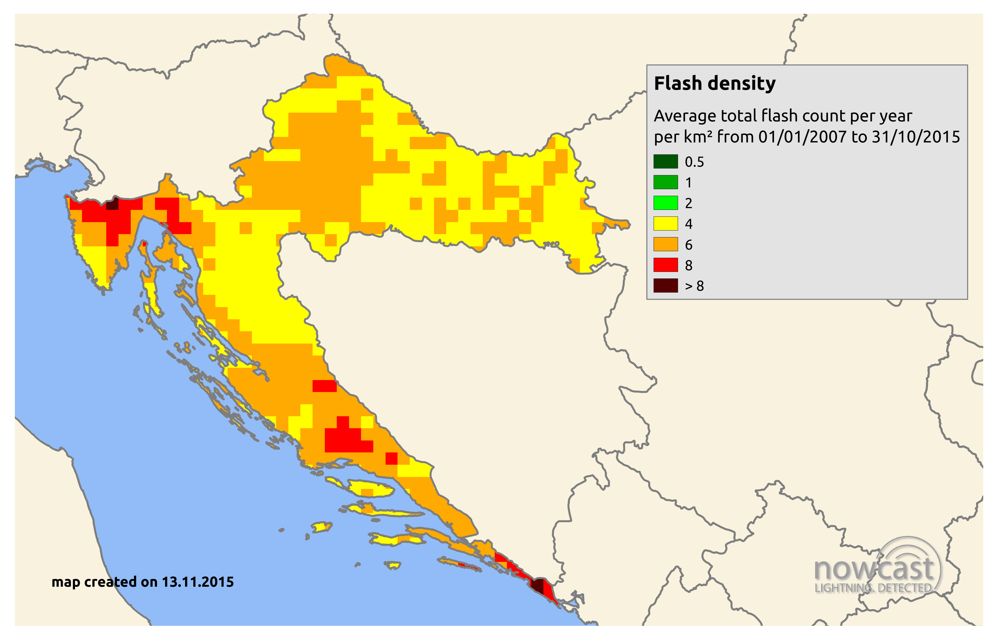

In [5]:
Image(filename='croatia_total_flashes_per_year.png', width=600, height=400)

The dataset under consideration contains lightning information related to the geographical region of some 400 square-km to the north-east of the city of Šibenik, in the hinterland of the Adriatic coast of Croatia, EU.

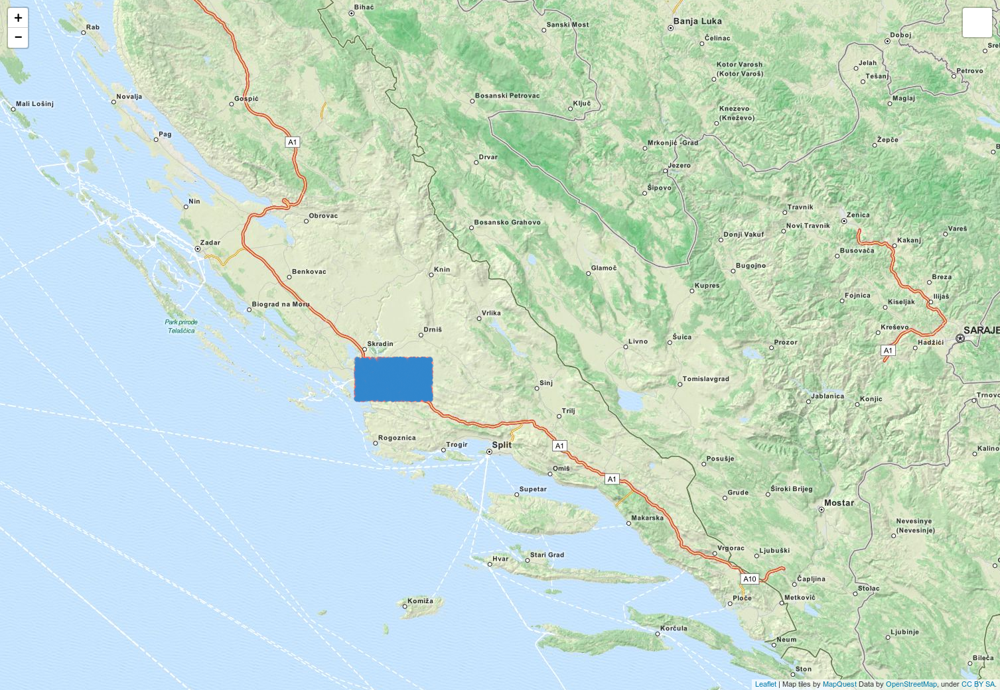

In [6]:
Image(filename='area-map.png', width=600, height=400)

There are four wind farms situated within this region, as indicated on the google map below.

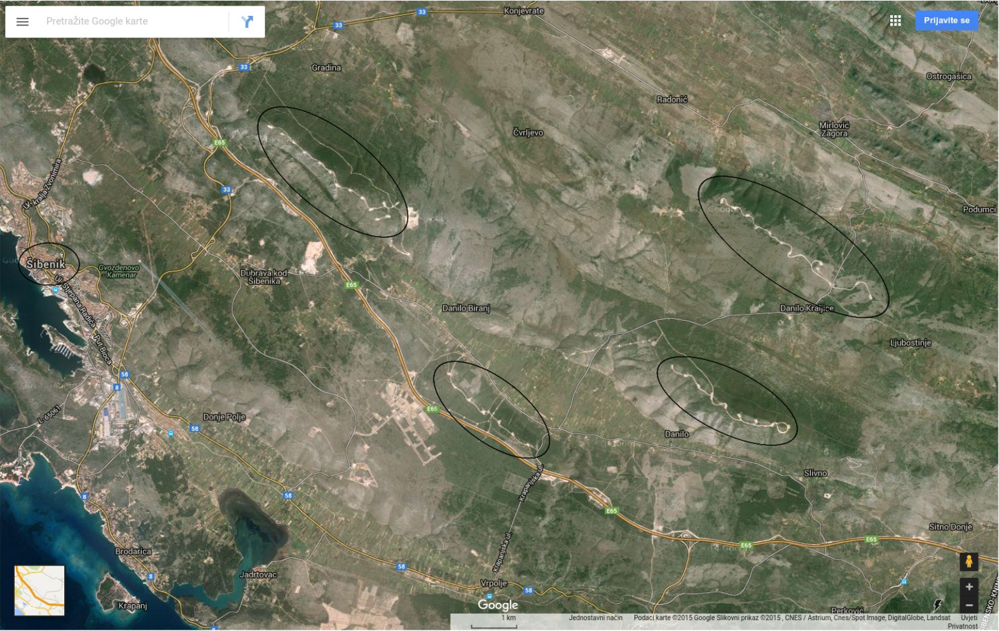

In [7]:
Image(filename='google-map.png', width=600, height=400)

First, a dataset needs to be read-in and pandas dataframe created for further processing. Date-and-time information needs to be preserved in order to use the pandas time-series functionality later on.

In [8]:
# Read lightning data from external file (not csv)
filename = 'lightning_data_20140101_20141231.txt'
date_li = []
time_li = []
lon_li = []
lat_li = []
type_li = []
ampl_li = []
with open(filename, 'r') as fp:
    next(fp)  # skip the first line (column names)
    for line in fp:
        d, t, lon, lat, ty, am = line.split()
        date_li.append(d)
        time_li.append(t)
        lon_li.append(float(lon))
        lat_li.append(float(lat))
        type_li.append(int(ty))
        ampl_li.append(float(am))
# Convert date and time to datetime objects
date_time = []
for d, t in zip(date_li, time_li):
    y, m, d = d.split('-')
    hr, mnt, sec = t.split(':')
    msec, sec = modf(float(sec))
    msec *= 1e6  # datetime needs microseconds
    date_time.append(dt.datetime(int(y), int(m), int(d),
                                 int(hr), int(mnt), int(sec), int(msec)))

# Create pandas dataframe
# Type 1 refers to a cloud-to-ground stroke, type 2 to an in-cloud stroke
li = pd.DataFrame({'lat': lat_li, 'lon': lon_li, 'type': type_li, 'ampl': ampl_li}, index=date_time)
print(li.head())

                             ampl     lat     lon  type
2014-01-19 18:44:05.767000  -23.3  43.696  15.901     1
2014-01-19 18:44:06.176000    5.9  43.702  15.938     2
2014-01-19 18:51:20.268000 -116.6  43.743  15.894     1
2014-01-19 18:53:58.817000    9.9  43.778  15.901     1
2014-01-19 23:13:53.932999   -5.1  43.674  15.918     1


In [9]:
# Adding column with lightning polarity
# -1 for negative lightning
#  1 for positive lightning
li['pol'] = np.array([1 if x > 0 else -1 for x in li['ampl']])
li.head(10)

,ampl,lat,lon,type,pol
2014-01-19 18:44:05.767000,-23.3,43.696,15.901,1,-1
2014-01-19 18:44:06.176000,5.9,43.702,15.938,2,1
2014-01-19 18:51:20.268000,-116.6,43.743,15.894,1,-1
2014-01-19 18:53:58.817000,9.9,43.778,15.901,1,1
2014-01-19 23:13:53.932999,-5.1,43.674,15.918,1,-1
2014-01-19 23:19:50.921999,-11.0,43.723,15.940,1,-1
2014-01-19 23:20:35.863999,-42.4,43.671,15.911,1,-1
2014-01-19 23:20:35.921999,-22.6,43.674,15.917,1,-1
2014-01-19 23:21:59.959000,-71.9,43.688,15.904,1,-1
2014-01-19 23:21:59.981999,-19.3,43.684,15.915,1,-1


In [10]:
# Days with lightning activity
dtemp = li['ampl'].resample('D', how='count').dropna()
dtemp = dtemp[dtemp > 0]
print('Total No. days with lightning activity: {:g}'.format(len(dtemp.index)))

Total No. days with lightning activity: 71


In [11]:
# Top days with lightning activity
dftemp = pd.DataFrame({'count': dtemp.values}, index=dtemp.index)
dftemp = dftemp.sort_values(by='count', ascending=False)
print('Top days with lightning activity:')
dftemp.head(10)

Top days with lightning activity:


,count
2014-09-01,1769
2014-08-21,759
2014-08-22,674
2014-09-12,644
2014-02-27,522
2014-12-04,504
2014-08-03,502
2014-09-22,359
2014-06-30,334
2014-08-23,325


In [12]:
dtempg = li.groupby('type').get_group(1)  # CG lightning
dtempg = dtempg['ampl'].resample('D', how='count').dropna()
dtempg = dtempg[dtempg > 0]
print('No. days with CG lightning activity: {:g}'.format(len(dtempg.index)))

No. days with CG lightning activity: 68


In [13]:
print('Largest recorded CG negative amplitude {:g} (kA)'.format(np.min(li['ampl'])))
print('Largest recorded CG positive amplitude {:g} (kA)'.format(np.max(li['ampl'])))

Largest recorded CG negative amplitude -150.3 (kA)
Largest recorded CG positive amplitude 168.9 (kA)


In [14]:
# Create pandas groups according to lightning type and polarity
# CG - cloud-to-ground lightning
# CC - cloud-to-cloud lightning
gr = li.groupby(['type', 'pol'])
cg_neg = gr.get_group((1, -1))  # Negative Cloud-to-Ground Lightning data
cg_poz = gr.get_group((1, 1))   # Positive Cloud-to-Ground Lightning data
cc_neg = gr.get_group((2, -1))  # Negative Cloud-to-Cloud Lightning data
cc_poz = gr.get_group((2, 1))   # Positive Cloud-to-Cloud Lightning data

print('Total No. of lightning strikes in database: {:g}'.format(li['ampl'].values.size))
print('Total No. of CG Negative strikes: {:g}'.format(cg_neg['ampl'].values.size))
print('Total No. of CG Positive strikes: {:g}'.format(cg_poz['ampl'].values.size))
print('Total No. of CC Negative strikes: {:g}'.format(cc_neg['ampl'].values.size))
print('Total No. of CC Positive strikes: {:g}'.format(cc_poz['ampl'].values.size))

Total No. of lightning strikes in database: 9513
Total No. of CG Negative strikes: 4530
Total No. of CG Positive strikes: 2580
Total No. of CC Negative strikes: 670
Total No. of CC Positive strikes: 1733


As can be seen, there are 71 days with lightning activity in the dataset, of which 68 days have cloud-to-ground lightning strikes. This is much more than reported on the traditional keraunic maps of the region (which are based on the keraunic days obtained by national weather service). Whatsmore, there are days with very intensive lightning activity (more than thousand strikes), which count as a single thunderstorm day. This clearly shows the deficiency of the thunderstorm day as a measure of regional lightning activity. Furthermore, proportion of positive cloud-to-ground lightning relative to the negative cloud-to-ground lightning is larger than traditionaly reported. Keraunic maps are aggregated from the long-term averages, but it is clear that they can't capture the local variations of lightning denisity.

In [15]:
print('Cloud-to-Ground Negative:')
cg_neg['ampl'].describe()

Cloud-to-Ground Negative:


count    4530.000000
mean      -12.648962
std        12.982096
min      -150.300000
25%       -14.300000
50%        -8.700000
75%        -5.600000
max        -1.700000
Name: ampl, dtype: float64

In [16]:
print('Cloud-to-Ground Positive:')
cg_poz['ampl'].describe()

Cloud-to-Ground Positive:


count    2580.000000
mean        8.200504
std        10.456577
min         1.600000
25%         4.400000
50%         5.500000
75%         8.100000
max       168.900000
Name: ampl, dtype: float64

In [17]:
print('Cloud-to-Cloud Negative:')
cc_neg['ampl'].describe()

Cloud-to-Cloud Negative:


count    670.000000
mean      -6.739552
std        6.426236
min      -86.000000
25%       -6.775000
50%       -5.150000
75%       -4.400000
max       -1.800000
Name: ampl, dtype: float64

In [18]:
print('Cloud-to-Cloud Positive:')
cc_poz['ampl'].describe()

Cloud-to-Cloud Positive:


count    1733.000000
mean        6.230467
std         4.220510
min         1.800000
25%         4.300000
50%         5.100000
75%         6.800000
max        63.200000
Name: ampl, dtype: float64

Basic statistical analysis of CG and CC lightning data reveals that the median amplitude of CG negative and CG positive lightning are lower than traditionally reported. This has been confirmed by the analysis carried out on longer time-spans and for larger geographical areas. It ought to be stated that the dataset does not discriminate between the first and subsequent strokes within the lightning flash, which can be of some importance for negative CG strikes. The analysis of LINET data on large scale will probably lead to the abolition of the keraunic day as a measure of the regions lightning activity, as well as to the redefinition of parameters of statistical distributions of CG lightning.

### Interactive geographical map of lightning activity

The lightning information from the dataset can be graphically depicted on the interactive geographical map (using folium). This map, shown below, features all cloud-to-ground lightning strikes, where positive strikes are depicted with blue circles and negative strikes with red circles. The size of the circle is the indication of the amplitude (larger circle means larger amplitude). The map is interactive. By left-clicking on any of the circles a popup displays the exact value of the lightning current amplitudes (in kilo-amperes), including the polarity. The map also features positions of wind turbines in four wind parks within this region. The map can also be panned and zoomed in or out.

In [19]:
# Wind turbine positions (from google maps)
with open('wind_farms.p', 'rb') as file_name:
    wind_farms = pickle.load(file_name)
wind_farm_1 = wind_farms[0]
wind_farm_2 = wind_farms[1]
wind_farm_3 = wind_farms[2]
wind_farm_4 = wind_farms[3]

In [20]:
# Extract lat-lon and amplitude data
lat_cg_neg = cg_neg['lat']
lat_cg_poz = cg_poz['lat']
lon_cg_neg = cg_neg['lon']
lon_cg_poz = cg_poz['lon']
ampl_neg = cg_neg['ampl']
ampl_poz = cg_poz['ampl']

In [21]:
clustered_view = False
# Folium maps (lat-lon data)
mapa = folium.Map(location=[43.72, 16.05], zoom_start=13)
# Wind farm 1
for key, val in wind_farm_1.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='green')).add_to(mapa)
# Wind farm 2
for key, val in wind_farm_2.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='orange')).add_to(mapa)
# Wind farm 3
for key, val in wind_farm_3.iteritems():
    mapa.simple_marker(location=[val[0], val[1]], popup=key,
                       marker_color='red', marker_icon='info-sign')
# Wind farm 4
for key, val in wind_farm_4.iteritems():
    mapa.simple_marker(location=[val[0], val[1]], popup=key,
                       marker_color='blue', marker_icon='info-sign')
# Negative lightning
for lat, lon, ampl in zip(lat_cg_neg, lon_cg_neg, ampl_neg):
    mapa.circle_marker(location=[lat, lon], radius=abs(ampl), popup='{:.1f} kA'.format(ampl),
                       line_color='#ff6666', fill_color='#ff6666')
# Positive lightning
for lat, lon, ampl in zip(lat_cg_poz, lon_cg_poz, ampl_poz):
    mapa.circle_marker(location=[lat, lon], radius=ampl, popup='{:.1f} kA'.format(ampl),
                       line_color='#3186cc', fill_color='#3186cc')
if clustered_view:
    # Clustered view of aggregated positive and negative lightning
    marker_cluster = folium.MarkerCluster().add_to(mapa)
    for lat, lon in zip(np.r_[lat_cg_neg, lat_cg_poz], np.r_[lon_cg_neg, lon_cg_poz]):
        #mapa.simple_marker(location=[lat, lon], clustered_marker=True)
        folium.Marker([lat, lon]).add_to(marker_cluster)
mapa.create_map(path='lightning-map.html')

In [22]:
# Display map: folium ver. 0.2.0
mapa

## Analytical & visual exploration of lightning dataset

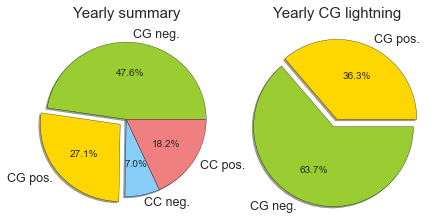

In [23]:
# Piechart of annual lightning activity by type and polarity
fig, ax = plt.subplots(1, 2, figsize=(6, 3.2))
plt.axis('equal')
labels = ['CG neg.', 'CG pos.', 'CC neg.', 'CC pos.']
sizes = [cg_neg['ampl'].values.size/float(li['ampl'].values.size),
         cg_poz['ampl'].values.size/float(li['ampl'].values.size),
         cc_neg['ampl'].values.size/float(li['ampl'].values.size),
         cc_poz['ampl'].values.size/float(li['ampl'].values.size)]
colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral']
explode = [0, 0.1, 0, 0]  # only "explode" the 2nd slice
# The slices will be ordered and plotted counter-clockwise
ax[0].set_title('Yearly summary')
ax[0].pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%.1f%%', shadow=True)
cg_suma = cg_neg['ampl'].values.size + cg_poz['ampl'].values.size
sizes = [cg_poz['ampl'].values.size/float(cg_suma), cg_neg['ampl'].values.size/float(cg_suma)]
ax[1].set_title('Yearly CG lightning')
ax[1].pie(sizes, explode=[0, 0.1], labels=['CG pos.', 'CG neg.'],
             colors=['gold', 'yellowgreen'], autopct='%.1f%%', shadow=True)
plt.tight_layout()
plt.show()

### Monthly lightning activity

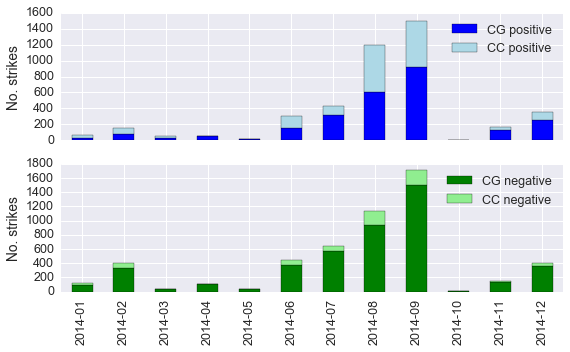

In [24]:
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
# Monthly number of lightning strikes (neg-pos)
gm = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m')]).count()['ampl']
# gm = li.groupby(['type', 'pol', li.index.month]).count()['ampl']  # alternative to previous line
gm = pd.concat([gm[1, 1], gm[2, 1], gm[1, -1], gm[2, -1]],
               axis=1, join='outer', keys=['cgp', 'ccp', 'cgn', 'ccn']).fillna(0)
# Visualize CG and CC lightning data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(8, 5))
gm['cgp'].plot(kind='bar', color='blue', label='CG positive', ax=ax[0])
gm['ccp'].plot(kind='bar', color='lightblue', bottom=gm['cgp'], label='CC positive', ax=ax[0])
gm['cgn'].plot(kind='bar', color='green', label='CG negative', ax=ax[1])
gm['ccn'].plot(kind='bar', color='lightgreen', bottom=gm['cgn'], label='CC negative', ax=ax[1])
ax[0].legend(loc='best')
ax[1].legend(loc='best')
ax[0].set_ylabel('No. strikes')
ax[1].set_ylabel('No. strikes')
plt.tight_layout()
plt.show()

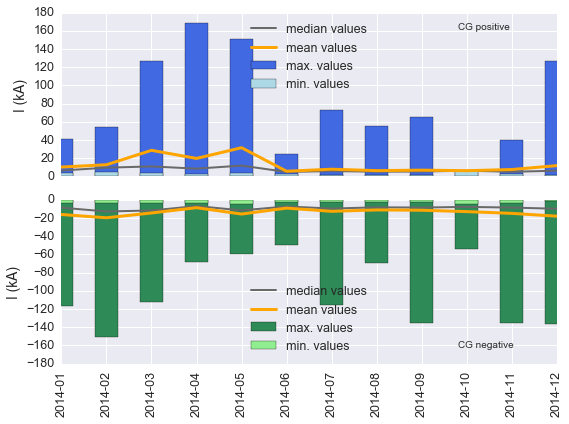

In [25]:
# Aggregate monthly data
gd1 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m')]).min()['ampl']
gd2 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m')]).max()['ampl']
gd3 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m')]).mean()['ampl']
gd4 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m')]).median()['ampl']
gmfinal = pd.concat([gd1[1, 1], gd2[1, 1], gd2[1, -1], gd1[1, -1], gd3[1, 1], gd3[1, -1],
                     gd4[1, 1], gd4[1, -1]], axis=1, join='outer',
                    keys=['cgp_min', 'cgp_max', 'cgn_min', 'cgn_max', 'cgp_mean',
                          'cgn_mean', 'cgp_med', 'cgn_med']).fillna(0)
# Visualize monthly data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(8, 6))
ax[0].text(0.8, 0.9, 'CG positive', transform=ax[0].transAxes)
gmfinal['cgp_max'].plot(kind='bar', color='royalblue', label='max. values', ax=ax[0])
gmfinal['cgp_min'].plot(kind='bar', color='lightblue', label='min. values', ax=ax[0])
gmfinal['cgp_med'].plot(c='dimgrey', ls='-', lw=2, label='median values', ax=ax[0])
gmfinal['cgp_mean'].plot(c='orange', ls='-', lw=3, label='mean values', ax=ax[0])
ax[1].text(0.8, 0.1, 'CG negative', transform=ax[1].transAxes)
gmfinal['cgn_max'].plot(kind='bar', color='seagreen', label='max. values', ax=ax[1])
gmfinal['cgn_min'].plot(kind='bar', color='lightgreen', label='min. values', ax=ax[1])
gmfinal['cgn_med'].plot(c='dimgrey', ls='-', lw=2, label='median values', ax=ax[1])
gmfinal['cgn_mean'].plot(c='orange', ls='-', lw=3, label='mean values', ax=ax[1])
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)
ax[0].set_ylabel('I (kA)')
ax[1].set_ylabel('I (kA)')
ax[1].set_ylim(-180, 0)
ax[0].legend(loc='upper center')
ax[1].legend(loc='lower center')
plt.tight_layout()
plt.show()

Monthly aggregation and analysis of lightning dataset reveals a very intensive and strong lightning activity during the summer months (June to September), with very large number of cloud-to-ground strikes. Also, it reveals that the winter lightning is associated with a rather small number of CG strikes, but they have very large amplitudes. This phenomenon has not been reported in Croatia thusfar, but is well known for example in Japan.

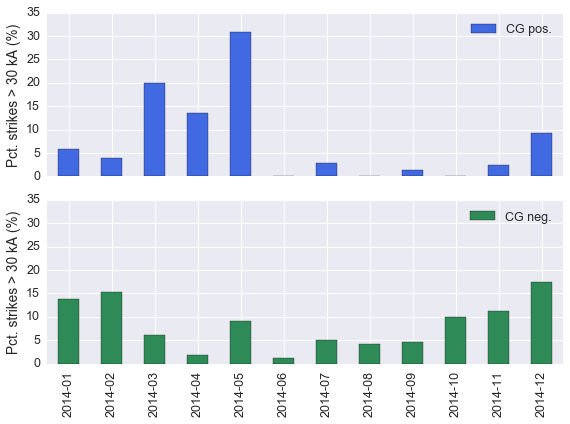

In [26]:
# Monthly distribution of *large* CG lightning amplitudes (neg-pos)
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(8, 6))
large_neg = cg_neg['ampl'].ix[cg_neg['ampl'] < -30].resample('1M', how='count').fillna(0)
total_neg = cg_neg['ampl'].resample('1M', how='count').fillna(0)
# Monthly percentage of "large" CG neg. aplitudes
large_neg_pct = (large_neg/total_neg)*100.
large_poz = cg_poz['ampl'].ix[cg_poz['ampl'] > 30].resample('1M', how='count').fillna(0)
total_poz = cg_poz['ampl'].resample('1M', how='count').fillna(0)
# Monthly percentage of "large" CG pos. aplitudes
large_poz_pct = (large_poz/total_poz)*100.
large_poz_pct.plot(kind='bar', color='royalblue', label='CG pos.', ax=ax[0])
large_neg_pct.plot(kind='bar', color='seagreen', label='CG neg.', ax=ax[1])
ax[0].legend(loc='best')
ax[1].legend(loc='best')
ax[0].set_ylabel('Pct. strikes > 30 kA (%)')
ax[1].set_ylabel('Pct. strikes > 30 kA (%)')
ax[0].set_ylim(0, 35)  # y-axis range is the same for both
ax[1].set_ylim(0, 35)  # lightning types for easier comparison
# Format x-axis labels (disply only year-month notation)
labels = [item.get_text().split()[0][:-3] for item in ax[1].get_xticklabels()]
ax[1].set_xticklabels(labels)
plt.tight_layout()
plt.show()

Lightning-current amplitudes in excess of 30 kA are more common during winter months then during the summer months, although number of lightning strikes during summer season is much larger then during the winter season. This holds for both CG negative and positive lightning activity, although it is more pronounced for CG positive lightning.

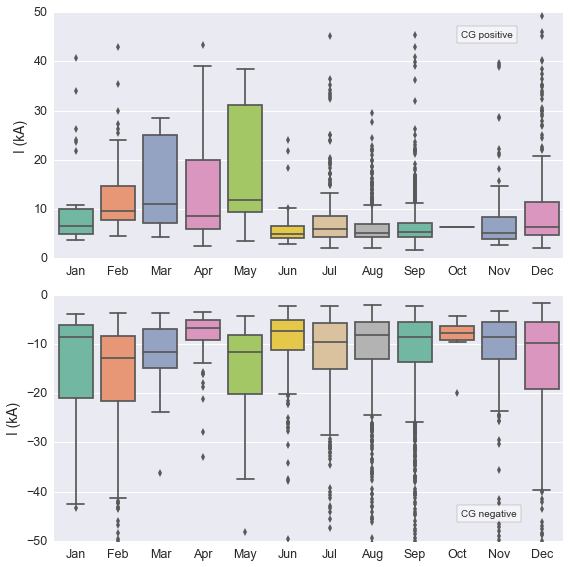

In [27]:
# Boxplot of aggregated monthly data
# Negative lightning
months_neg = cg_neg['ampl'].groupby(lambda x: x.month)
data_months_neg = OrderedDict()
for name, i in zip(month_names, range(1, 13)):
    data_months_neg[name] = pd.Series(months_neg.get_group(i).values)
data_neg_pd = pd.DataFrame(data_months_neg)
# Positive lightning
months_poz = cg_poz['ampl'].groupby(lambda x: x.month)
data_months_poz = OrderedDict()
for name, i in zip(month_names, range(1, 13)):
    data_months_poz[name] = pd.Series(months_poz.get_group(i).values)
data_poz_pd = pd.DataFrame(data_months_poz)
# Seaborn boxplot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sns.boxplot(data=data_poz_pd, orient='v', palette='Set2', ax=ax1)
sns.boxplot(data=data_neg_pd, orient='v', palette='Set2', ax=ax2)
ax1.text(0.8, 0.9, 'CG positive', bbox=dict(facecolor='white', alpha=0.5), transform=ax1.transAxes)
ax2.text(0.8, 0.1, 'CG negative', bbox=dict(facecolor='white', alpha=0.5), transform=ax2.transAxes)
ax1.set_ylim(0, 50)
ax2.set_ylim(-50, 0)
ax1.set_ylabel('I (kA)')
ax2.set_ylabel('I (kA)')
plt.tight_layout()
plt.show()

### Seasonal lightning activity

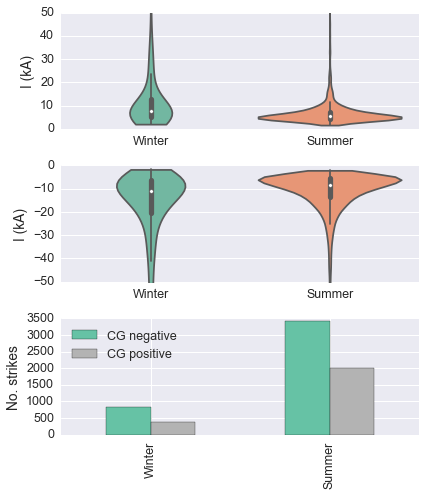

In [28]:
# Aggregate seasonal data
# Winter season: Dec, Jan, Feb, Mar
# Summer season: Jun, Jul, Aug, Sep
# Negative lightning amplitudes
season_neg = OrderedDict()
winter = [months_neg.get_group(i).values for i in [12, 1, 2, 3]]
winter = np.concatenate((winter[0], winter[1], winter[2], winter[3]))
season_neg['Winter'] = pd.Series(winter)
summer = [months_neg.get_group(i).values for i in [6, 7, 8, 9]]
summer = np.concatenate((summer[0], summer[1], summer[2], summer[3]))
season_neg['Summer'] = pd.Series(summer)
season_neg_pd = pd.DataFrame(season_neg)
# Positive lightning amplitudes
season_poz = OrderedDict()
winter = [months_poz.get_group(i).values for i in [12, 1, 2, 3]]
winter = np.concatenate((winter[0], winter[1], winter[2], winter[3]))
season_poz['Winter'] = pd.Series(winter)
summer = [months_poz.get_group(i).values for i in [6, 7, 8, 9]]
summer = np.concatenate((summer[0], summer[1], summer[2], summer[3]))
season_poz['Summer'] = pd.Series(summer)
season_poz_pd = pd.DataFrame(season_poz)
# Negative No. strikes
win_neg = np.sum([months_neg.get_group(i).count() for i in [12, 1, 2, 3]])
win_poz = np.sum([months_poz.get_group(i).count() for i in [12, 1, 2, 3]])
sum_neg = np.sum([months_neg.get_group(i).count() for i in [6, 7, 8, 9]])
sum_poz = np.sum([months_poz.get_group(i).count() for i in [6, 7, 8, 9]])
seasons = pd.DataFrame(data={'CG positive': [win_poz, sum_poz],
                             'CG negative': [win_neg, sum_neg]}, index=['Winter', 'Summer'])
# Violinplot of aggregated seasonal data
fig, ax = plt.subplots(3, 1, figsize=(6, 7))
sns.violinplot(data=season_poz_pd, orient='v', cut=0, palette='Set2', ax=ax[0])
sns.violinplot(data=season_neg_pd, orient='v', cut=0, palette='Set2', ax=ax[1])
seasons.plot(kind='bar', cmap=plt.cm.get_cmap('Set2'), ax=ax[2])
ax[0].set_ylabel('I (kA)')
ax[1].set_ylabel('I (kA)')
ax[2].set_ylabel('No. strikes')
ax[0].set_ylim(0, 50)
ax[1].set_ylim(-50, 0)
plt.tight_layout()
plt.show()

This violinplot shows that summer and winter lightning are very different in terms of number of strikes and amplitudes distribution. The statistical distribution of winter lightning has much fatter tails than summer lightning distribution, indicating higher proportion of large amplitudes.

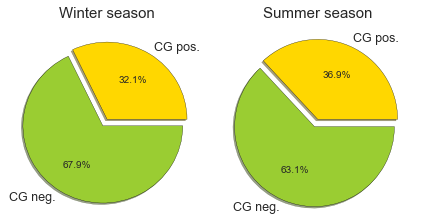

In [29]:
# Piechart of seasonal lightning activity by type and polarity
fig, ax = plt.subplots(1, 2, figsize=(6, 3.2))
plt.axis('equal')
sizes = [win_poz/float(win_poz+win_neg), win_neg/float(win_poz+win_neg)]
ax[0].set_title('Winter season')
ax[0].pie(sizes, explode=[0, 0.1], labels=['CG pos.', 'CG neg.'],
             colors=['gold', 'yellowgreen'], autopct='%.1f%%', shadow=True)
sizes = [sum_poz/float(sum_poz+sum_neg), sum_neg/float(sum_poz+sum_neg)]
ax[1].set_title('Summer season')
ax[1].pie(sizes, explode=[0, 0.1], labels=['CG pos.', 'CG neg.'],
             colors=['gold', 'yellowgreen'], autopct='%.1f%%', shadow=True)
plt.tight_layout()
plt.show()

### Weekly lightning activity

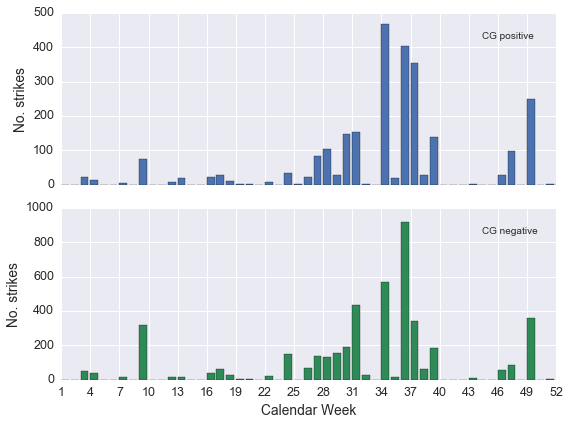

In [30]:
# Aggregate weekly data
lw = li.groupby(['type', 'pol'])
weeks = pd.date_range(start='2014-01-01', end='2014-12-31', freq='W')
wgp_cnt = lw.get_group((1, 1))['ampl'].resample('1W', how='count')
wgp_max = lw.get_group((1, 1))['ampl'].resample('1W', how='max')
wgp_med = lw.get_group((1, 1))['ampl'].resample('1W', how='median')
wgp_man = lw.get_group((1, 1))['ampl'].resample('1W', how='mean')
wgn_cnt = lw.get_group((1, -1))['ampl'].resample('1W', how='count')
wgn_max = lw.get_group((1, -1))['ampl'].resample('1W', how='min')
wgn_med = lw.get_group((1, -1))['ampl'].resample('1W', how='median')
wgn_man = lw.get_group((1, -1))['ampl'].resample('1W', how='mean')
# Visualize weekly data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(8, 6))
weeks_x = np.arange(1, 53, 1)  # calendar weeks for x axis
ax[0].bar(weeks_x, wgp_cnt.ix[weeks].fillna(0))
ax[0].text(0.85, 0.85, 'CG positive', transform=ax[0].transAxes)
ax[0].set_xlim(1, 52)
ax[0].set_ylabel('No. strikes')
ax[1].bar(weeks_x, wgn_cnt.ix[weeks].fillna(0), color='seagreen')
ax[1].text(0.85, 0.85, 'CG negative', transform=ax[1].transAxes)
ax[1].set_ylabel('No. strikes')
ax[1].set_xlabel('Calendar Week')
ax[1].set_xticks(np.arange(1, 53, 3))  # set xticks
plt.tight_layout()
plt.show()

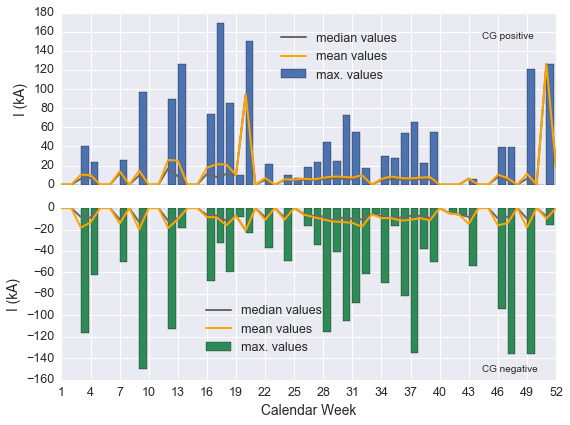

In [31]:
# Visualize weekly data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(8, 6))
ax[0].bar(weeks_x, wgp_max.ix[weeks].fillna(0), label='max. values')
ax[0].plot(weeks_x, wgp_med.ix[weeks].fillna(0), c='dimgrey', ls='-', lw=2, label='median values')
ax[0].plot(weeks_x, wgp_man.ix[weeks].fillna(0), c='orange', ls='-', lw=2, label='mean values')
ax[0].text(0.85, 0.85, 'CG positive', transform=ax[0].transAxes)
ax[0].legend(bbox_to_anchor=[0.7, 0.95])  # manually position legend
ax[0].set_ylabel('I (kA)')
ax[0].set_xlim(1, 52)
ax[1].bar(weeks_x, wgn_max.ix[weeks].fillna(0), color='seagreen', label='max. values')
ax[1].plot(weeks_x, wgn_med.ix[weeks].fillna(0), c='dimgrey', ls='-', lw=2, label='median values')
ax[1].plot(weeks_x, wgn_man.ix[weeks].fillna(0), c='orange', ls='-', lw=2, label='mean values')
ax[1].text(0.85, 0.05, 'CG negative', transform=ax[1].transAxes)
ax[1].legend(bbox_to_anchor=[0.55, 0.5])  # manually position legend
ax[1].set_ylabel('I (kA)')
ax[1].set_xticks(np.arange(1, 53, 3))  # set xticks
ax[1].set_xlabel('Calendar Week')
plt.tight_layout()
plt.show()

Weekly aggregation and analysis of lightning activity clearly reveals the low values of both mean and median lightning-current amplitude values. Majority of lightning strikes are associated with low current amplitudes.

### Daily lightning activity

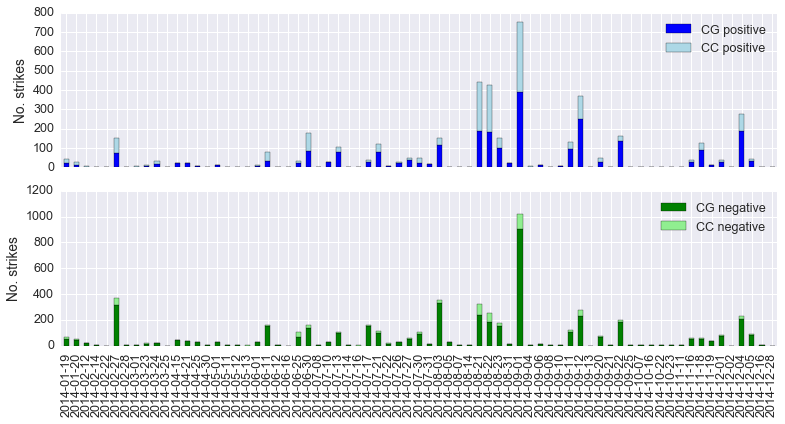

In [32]:
# Daily number of strikes (neg-pos)
gd = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m-%d')]).count()['ampl']
# gd[1, 1]  CG positive
# gd[1, -1] CG negative
# gd[2, 1]  CC positive
# gd[2, -1] CC negative
gd = pd.concat([gd[1, 1], gd[2, 1], gd[1, -1], gd[2, -1]],
               axis=1, join='outer', keys=['cgp', 'ccp', 'cgn', 'ccn']).fillna(0)
# cgp - cloud-to-ground positive
# ccp - cloud-to-cloud positive
# cgn - cloud-to-ground negative
# ccn - cloud-to-cloud negative
# Visualize CG and CC lightning data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(11, 6))
gd['cgp'].plot(kind='bar', color='blue', label='CG positive', ax=ax[0])
gd['ccp'].plot(kind='bar', color='lightblue', bottom=gd['cgp'], label='CC positive', ax=ax[0])
gd['cgn'].plot(kind='bar', color='green', label='CG negative', ax=ax[1])
gd['ccn'].plot(kind='bar', color='lightgreen', bottom=gd['cgn'], label='CC negative', ax=ax[1])
ax[0].legend(loc='best')
ax[1].legend(loc='best')
ax[0].set_ylabel('No. strikes')
ax[1].set_ylabel('No. strikes')
plt.tight_layout()
plt.show()

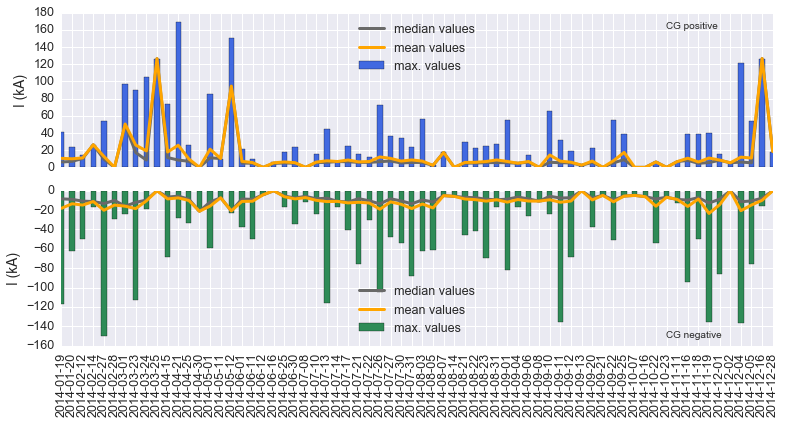

In [33]:
# Aggregate daily data
gd1 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m-%d')]).min()['ampl']
gd2 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m-%d')]).max()['ampl']
gd3 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m-%d')]).mean()['ampl']
gd4 = li.groupby(['type', 'pol', lambda x: x.strftime('%Y-%m-%d')]).median()['ampl']
gdfinal = pd.concat([gd2[1, 1], gd1[1, -1], gd3[1, 1], gd3[1, -1], gd4[1, 1], gd4[1, -1]], axis=1, join='outer',
                    keys=['cgp', 'cgn', 'cgp_mean', 'cgn_mean', 'cgp_med', 'cgn_med']).fillna(0)
# Visualize daily data
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(11, 6))
gdfinal['cgp'].plot(kind='bar', color='royalblue', label='max. values', ax=ax[0])
gdfinal['cgp_med'].plot(c='dimgrey', ls='-', lw=3, label='median values', ax=ax[0])
gdfinal['cgp_mean'].plot(c='orange', ls='-', lw=3, label='mean values', ax=ax[0])
ax[0].text(0.85, 0.9, 'CG positive', transform=ax[0].transAxes)
gdfinal['cgn'].plot(kind='bar', color='seagreen', label='max. values', ax=ax[1])
gdfinal['cgn_med'].plot(c='dimgrey', ls='-', lw=3, label='median values', ax=ax[1])
gdfinal['cgn_mean'].plot(c='orange', ls='-', lw=3, label='mean values', ax=ax[1])
ax[1].text(0.85, 0.05, 'CG negative', transform=ax[1].transAxes)
locs, labels = plt.xticks()    # get x-axis labels
plt.setp(labels, rotation=90)  # rotate x-axis labels
ax[0].set_ylabel('I (kA)')
ax[1].set_ylabel('I (kA)')
ax[0].legend(loc='best')
ax[1].legend(loc='best')
plt.tight_layout()
plt.show()

Daily aggregation and analysis of lightning activity reveals that there are days with extreme lightning activity, making the thunderstorm day based lightning activity depiction very crude and ineffective.

### Diurnal lightning activity

Total No. strikes at 2014-09-01: 1769
Total No. *CG* strikes at 2014-09-01: 1290


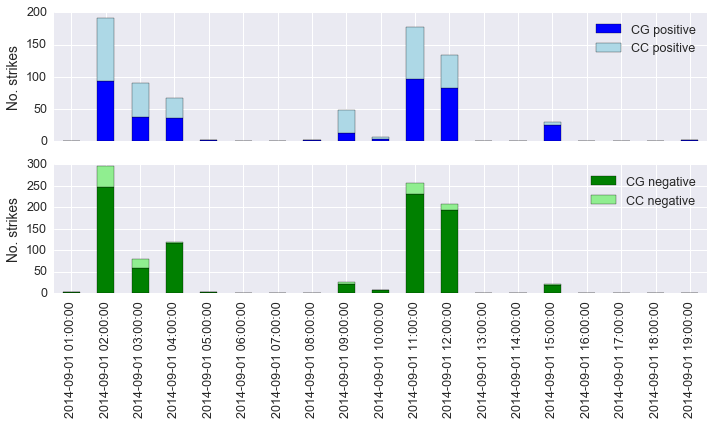

In [34]:
# Aggregate lightning activity for a single day
date = '2014-09-01'
print('Total No. strikes at {:s}: {:g}'.format(date, len(li['ampl'].ix[date])))
cg_date = li.groupby('type').get_group(1)['ampl'].ix[date]
print('Total No. *CG* strikes at {:s}: {:g}'.format(date, len(cg_date)))
lh = li.groupby(['type', 'pol'])
# No. strikes (count)
hgp = lh.get_group((1, 1))['ampl'].ix[date].resample('1H', how='count').fillna(0)
hgn = lh.get_group((1, -1))['ampl'].ix[date].resample('1H', how='count').fillna(0)
hcp = lh.get_group((2, 1))['ampl'].ix[date].resample('1H', how='count').fillna(0)
hcn = lh.get_group((2, -1))['ampl'].ix[date].resample('1H', how='count').fillna(0)
hfinal = pd.concat([hgp, hgn, hcp, hcn], axis=1, join='outer',
                   keys=['hgp', 'hgn', 'hcp', 'hcn']).fillna(0)
# Visualize diurnal lightning activity
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(10, 6))
hfinal['hgp'].plot(kind='bar', color='blue', label='CG positive', ax=ax[0])
hfinal['hcp'].plot(kind='bar', color='lightblue', bottom=hfinal['hgp'], label='CC positive', ax=ax[0])
hfinal['hgn'].plot(kind='bar', color='green', label='CG negative', ax=ax[1])
hfinal['hcn'].plot(kind='bar', color='lightgreen', bottom=hfinal['hgn'], label='CC negative', ax=ax[1])
ax[0].legend(loc='best')
ax[1].legend(loc='best')
ax[0].set_ylabel('No. strikes')
ax[1].set_ylabel('No. strikes')
plt.tight_layout()
plt.show()

At the date of 2014-09-01 the lightning activity was particularly intense, with over 1700 lightning incidents recorded, of which almost 1300 were cloud-to-ground lightning strikes. This kind of lightning activity is associated with passing of the thunderstorm. The diurnal distribution of lightning strikes reveals patterns (time windows) with very intense lightning activity. Furthermore, this activity is localized over a certain region, which can be seen from the map below.

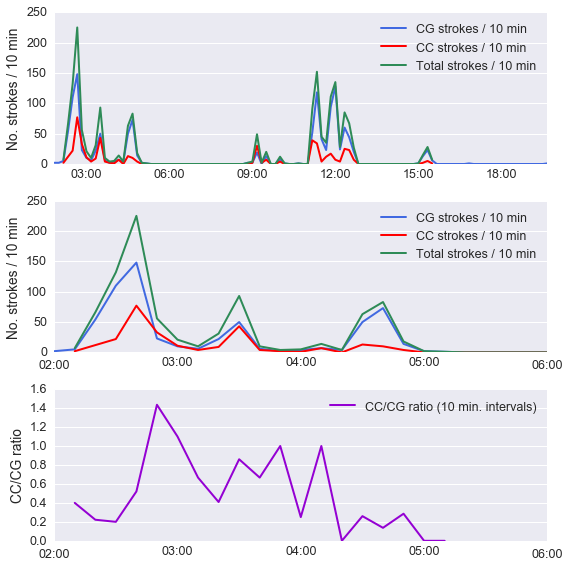

In [35]:
# Number of strokes within 10 minute intervals for the day
cg_date = li.groupby('type').get_group(1)['ampl'].ix[date]
cc_date = li.groupby('type').get_group(2)['ampl'].ix[date]
cg_num = cg_date.resample('10min', how='count').fillna(0)
cc_num = cc_date.resample('10min', how='count').fillna(0)
total = cg_num + cc_num

fig, ax = plt.subplots(3, 1, figsize=(8, 8))
cg_num.plot(color='royalblue', ls='-', lw=2, label='CG strokes / 10 min', ax=ax[0])
cc_num.plot(color='red', ls='-', lw=2, label='CC strokes / 10 min', ax=ax[0])
total.plot(color='seagreen', ls='-', lw=2, label='Total strokes / 10 min', ax=ax[0])
ax[0].legend(loc='best')
ax[0].set_ylabel('No. strokes / 10 min')
# zoom-in on time frame
ts = '2014-09-01 02:00:00'
te = '2014-09-01 06:00:00'
cg_num.ix[ts:te].plot(color='royalblue', ls='-', lw=2, label='CG strokes / 10 min', ax=ax[1])
cc_num.ix[ts:te].plot(color='red', ls='-', lw=2, label='CC strokes / 10 min', ax=ax[1])
total.ix[ts:te].plot(color='seagreen', ls='-', lw=2, label='Total strokes / 10 min', ax=ax[1])
ax[1].legend(loc='best')
ax[1].set_ylabel('No. strokes / 10 min')
# CC/CG ratio within 10 minute intervals
cc_cg_ratio = cc_num.ix[ts:te] / cg_num.ix[ts:te]
cc_cg_ratio.plot(color='darkviolet', ls='-', lw=2, label='CC/CG ratio (10 min. intervals)', ax=ax[2])
ax[2].legend(loc='best')
ax[2].set_ylabel('CC/CG ratio')
plt.tight_layout()
plt.show()

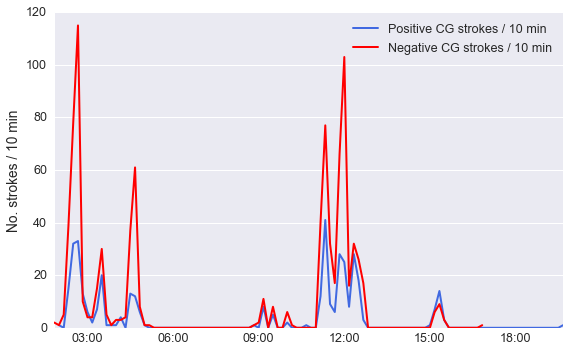

In [36]:
cg_poz_date = li.groupby(['type', 'pol']).get_group((1, 1))['ampl'].ix[date]
cg_poz_num = cg_poz_date.resample('10min', how='count').fillna(0)
cg_neg_date = li.groupby(['type', 'pol']).get_group((1, -1))['ampl'].ix[date]
cg_neg_num = cg_neg_date.resample('10min', how='count').fillna(0)

fig, ax = plt.subplots(figsize=(8, 5))
cg_poz_num.plot(color='royalblue', ls='-', lw=2, label='Positive CG strokes / 10 min', ax=ax)
cg_neg_num.plot(color='red', ls='-', lw=2, label='Negative CG strokes / 10 min', ax=ax)
ax.legend(loc='best')
ax.set_ylabel('No. strokes / 10 min')
plt.tight_layout()
plt.show()

Spikes in lightning intensity during 10 minute intervals indicates flash-cells, which can be identified and tracked using clustering algorithms (see below).

In [37]:
# Interactive map of lighting activity on 2014-09-01
mapa = folium.Map(location=[43.72, 16.05], zoom_start=12)
# Negative lightning
lon_09_01 = cg_neg['lon'].ix[date]
lat_09_01 = cg_neg['lat'].ix[date]
ampl_09_01 = cg_neg['ampl'].ix[date]
for lat, lon, ampl in zip(lat_09_01, lon_09_01, ampl_09_01):
    mapa.circle_marker(location=[lat, lon], radius=abs(ampl), popup='{:.1f} kA'.format(ampl),
                       line_color='#ff6666', fill_color='#ff6666')
# Positive lightning
lon_09_01 = cg_poz['lon'].ix[date]
lat_09_01 = cg_poz['lat'].ix[date]
ampl_09_01 = cg_poz['ampl'].ix[date]
for lat, lon, ampl in zip(lat_09_01, lon_09_01, ampl_09_01):
    folium.CircleMarker(location=[lat, lon], radius=ampl, popup='{:.1f} kA'.format(ampl),
                        color='#3186cc', fill_color='#3186cc').add_to(mapa)
mapa

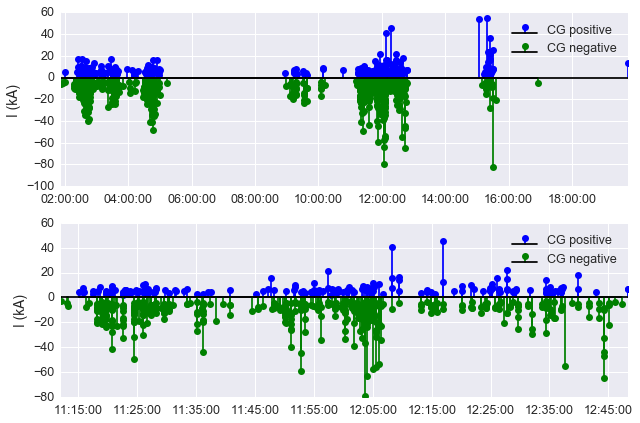

In [38]:
# Amplitudes
hgp_ampl = lh.get_group((1, 1))['ampl'].ix[date]
hgn_ampl = lh.get_group((1, -1))['ampl'].ix[date]
# Visualize using stem plot
fig, ax = plt.subplots(2, 1, figsize=(9, 6))
ax[0].stem(hgp_ampl.index, hgp_ampl.values, linefmt='b-', markerfmt='bo', basefmt='k-', label='CG positive')
ax[0].stem(hgn_ampl.index, hgn_ampl.values, linefmt='g-', markerfmt='go', basefmt='k-', label='CG negative')
# Zoom-in on time frame (11:00 - 13:30 h)
hgp_zoom = hgp_ampl.ix['2014-09-01 11:00:00':'2014-09-01 13:30:00']
hgn_zoom = hgn_ampl.ix['2014-09-01 11:00:00':'2014-09-01 13:30:00']
# Visualize using stem plot
ax[1].stem(hgp_zoom.index, hgp_zoom.values, linefmt='b-', markerfmt='bo', basefmt='k-', label='CG positive')
ax[1].stem(hgn_zoom.index, hgn_zoom.values, linefmt='g-', markerfmt='go', basefmt='k-', label='CG negative')
ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
ax[0].legend(loc='best')
ax[0].set_ylabel('I (kA)')
ax[1].legend(loc='best')
ax[1].set_ylabel('I (kA)')
plt.tight_layout()
plt.show()

It can be seen from the above figure that even the narrow time window (11:15 - 12:45 h) spanning some 1h 30min has plenty of lightning activity with large number of CG lightning strikes. This can be stated even for smaller time windows (i.e. 10min intervals).

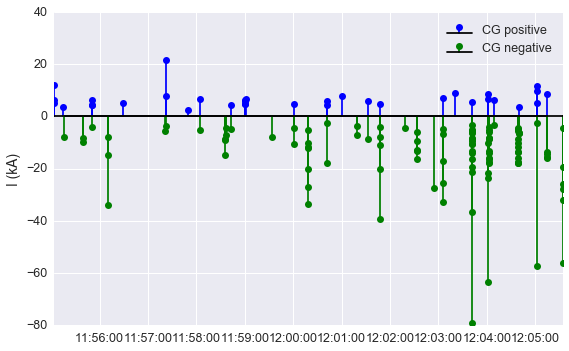

In [39]:
# Another zoom-in on time frame (11:55 - 12:05 h)
hgp_zoom2 = hgp_ampl.ix['2014-09-01 11:55':'2014-09-01 12:05']
hgn_zoom2 = hgn_ampl.ix['2014-09-01 11:55':'2014-09-01 12:05']
# Visualize using stem plot
fig, ax = plt.subplots(figsize=(8, 5))
hgp_x = hgp_zoom2.index.round('s')
hgn_x = hgn_zoom2.index.round('s')
ax.stem(hgp_x, hgp_zoom2.values, linefmt='b-', markerfmt='bo', basefmt='k-', label='CG positive')
ax.stem(hgn_x, hgn_zoom2.values, linefmt='g-', markerfmt='go', basefmt='k-', label='CG negative')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
ax.legend(loc='best')
ax.set_ylabel('I (kA)')
plt.tight_layout()
plt.show()

In [40]:
# Interactive map of lightning activity on 2014-09-01 with time-frame of 11:55 - 12:05 h
# Time frame is 11:55 - 12:05 (10 minute interval)
s = '2014-09-01 11:55:00'
e = '2014-09-01 12:05:00'
hgp_lon_zoom = cg_poz['lon'].ix[s:e]
hgp_lat_zoom = cg_poz['lat'].ix[s:e]
hgp_amp_zoom = cg_poz['ampl'].ix[s:e]
hgp_time_zoom = cg_poz.ix[s:e].index
hgn_lon_zoom = cg_neg['lon'].ix[s:e]
hgn_lat_zoom = cg_neg['lat'].ix[s:e]
hgn_amp_zoom = cg_neg['ampl'].ix[s:e]
hgn_time_zoom = cg_neg.ix[s:e].index
# Folium map
mapa = folium.Map(location=[43.72, 16.05], zoom_start=12)
# Negative lightning
for lat, lon, time, ampl in zip(hgn_lat_zoom, hgn_lon_zoom, hgn_time_zoom, hgn_amp_zoom):
    folium.CircleMarker(location=[lat, lon], radius=abs(ampl),
                        popup='{:s}, I = {:.1f} kA'.format(str(time), ampl),
                        color='#ff6666', fill_color='#ff6666').add_to(mapa)
# Positive lightning
for lat, lon, time, ampl in zip(hgp_lat_zoom, hgp_lon_zoom, hgp_time_zoom, hgp_amp_zoom):
    folium.CircleMarker(location=[lat, lon], radius=ampl,
                        popup='{:s}, I = {:.1f} kA'.format(str(time), ampl),
                        color='#3186cc', fill_color='#3186cc').add_to(mapa)
# Clustered view of aggregated positive and negative strikes
marker_cluster = folium.MarkerCluster().add_to(mapa)
for lat, lon in zip(np.r_[hgn_lat_zoom, hgp_lat_zoom], np.r_[hgn_lon_zoom, hgp_lon_zoom]):
    folium.Marker([lat, lon]).add_to(marker_cluster)
mapa

Left-clicking on any of the circles (representing lightning strike) a popup will display exact time of the strike and the associated amplitude.

### Statistical distribution of lightning current amplitudes

In [41]:
def number_of_bins(data, method='Freedman-Diaconis'):
    """
    :param data: 1d array of random data
    :param method: string, method for computing optimal number of bins; following
     values are valid: 'Freedman-Diaconis' (default), 'Sturges', 'Scott', 'Rice',
    'Square-root' and 'Simple'
    :return: scalar, optimal number of bins
    """
    n = len(data)
    if method == 'Freedman-Diaconis':
        q3 = np.percentile(data, 75)
        q1 = np.percentile(data, 25)
        iqr = q3 - q1
        h = 2.*iqr*n**(-1./3.)
        nbins = int(np.ceil((data.max()-data.min())/h))
    elif method == 'Sturges':
        nbins = int(np.ceil(np.log2(n) + 1))
    elif method == 'Scott':
        s = np.std(data)
        h = (3.5*s)/(n**(1./3.))
        nbins = int(np.ceil((data.max()-data.min())/h))
    elif method == 'Rice':
        nbins = int(np.ceil(2.*n**(1./3.)))
    elif method == 'Square-root':
        nbins = int(np.ceil((np.sqrt(n))))
    elif method == 'Simple':
        if n > 100:
            nbins = int(np.floor(10.*np.log10(n)))
        else:
            nbins = int(np.floor(2./np.sqrt(n)))
    else:
        raise Exception('Error calculating number of bins!')
    return nbins

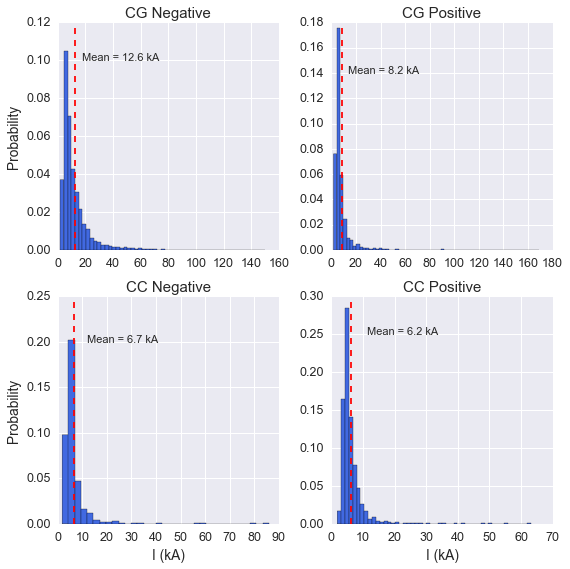

In [42]:
# Histograms of lightning current amplitudes distributions
fig, ax = plt.subplots(2, 2, figsize=(8, 8))
nb = number_of_bins(cg_neg['ampl'], method='Scott')
ax[0, 0].hist(abs(cg_neg['ampl']), bins=nb, normed=True, color='royalblue')
mean_val = np.mean(abs(cg_neg['ampl']))
ax[0, 0].axvline(mean_val, c='red', ls='--')
ax[0, 0].annotate('Mean = {:.1f} kA'.format(mean_val), xy=(mean_val+5, 0.1), fontsize=11)
nb = number_of_bins(cg_poz['ampl'], method='Scott')
ax[0, 1].hist(cg_poz['ampl'], bins=nb, normed=True, color='royalblue')
mean_val = np.mean(cg_poz['ampl'])
ax[0, 1].axvline(mean_val, c='red', ls='--')
ax[0, 1].annotate('Mean = {:.1f} kA'.format(mean_val), xy=(mean_val+5, 0.14), fontsize=11)
nb = number_of_bins(cc_neg['ampl'], method='Scott')
ax[1, 0].hist(abs(cc_neg['ampl']), bins=nb, normed=True, color='royalblue')
mean_val = np.mean(abs(cc_neg['ampl']))
ax[1, 0].axvline(mean_val, c='red', ls='--')
ax[1, 0].annotate('Mean = {:.1f} kA'.format(mean_val), xy=(mean_val+5, 0.2), fontsize=11)
nb = number_of_bins(cc_poz['ampl'], method='Scott')
ax[1, 1].hist(abs(cc_poz['ampl']), bins=nb, normed=True, color='royalblue')
mean_val = np.mean(cc_poz['ampl'])
ax[1, 1].axvline(mean_val, c='red', ls='--')
ax[1, 1].annotate('Mean = {:.1f} kA'.format(mean_val), xy=(mean_val+5, 0.25), fontsize=11)
ax[0, 0].set_title('CG Negative')
ax[0, 1].set_title('CG Positive')
ax[1, 0].set_title('CC Negative')
ax[1, 1].set_title('CC Positive')
ax[1, 0].set_xlabel('I (kA)')
ax[1, 1].set_xlabel('I (kA)')
ax[0, 0].set_ylabel('Probability')
ax[1, 0].set_ylabel('Probability')
plt.tight_layout()
plt.show()

Log-N dist. (CG neg.): (0.67720858645926563, 0, 9.5981923639596918)


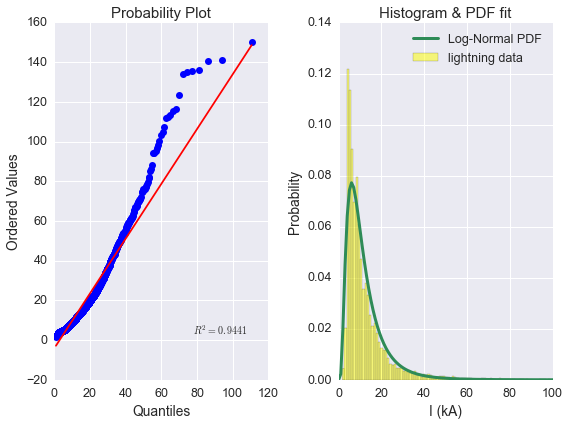

In [43]:
# Statistical distribution fit to lightning amplitudes data
# Fit a Log-Normal distribution to CG negative data
vals_neg = abs(cg_neg['ampl'].values)
prms_neg = stats.lognorm.fit(vals_neg, floc=0)
print('Log-N dist. (CG neg.):', prms_neg)
support = np.linspace(0, 200, 200)
fits_neg = stats.lognorm.pdf(support, *prms_neg)

# Visualize distribution fit (probplot & hist)
fig, ax = plt.subplots(1, 2, figsize=(8, 6))
nb_neg = number_of_bins(vals_neg)
stats.probplot(vals_neg, sparams=prms_neg, dist=stats.lognorm, fit=True, plot=ax[0])
ax[1].hist(vals_neg, bins=nb_neg, normed=True, color='yellow', alpha=0.5, label='lightning data')
ax[1].plot(support, fits_neg, color='seagreen', ls='-', lw=3, label='Log-Normal PDF')
ax[1].set_title('Histogram & PDF fit')
ax[1].set_xlabel('I (kA)')
ax[1].set_ylabel('Probability')
ax[1].set_xlim(0, 100)
ax[1].legend(loc='upper right', frameon=False)
plt.tight_layout()
plt.show()

From the probability plot it can be seen that the Log-Normal statistical distribution can be fitted (correlation coefficient of 0.944) to the CG lightning-current amplitudes derived from this dataset, although the fit at the higher quantiles becomes questionable, which has been reported even with larger datasets. The standard deviation of the distribution is close to the value generally reported for the CG lightning. However, the median is lower than generally assumed (lower then 30 kA). This has also been reported for larger datasets derived from the LINET network and may suggest that yet another detailed scrutiny of the statistical depiction of lightning data is necessary, aided by the LINET, NLDN and other important datasets.

In [44]:
# Fit a Log-Normal distribution to CG positive lightning data
vals_poz = cg_poz['ampl'].values
prms_poz = stats.lognorm.fit(vals_poz, floc=0)
print('Log-N (CG pos.): I = {:.2f}, Sigma = {:.4f}'.format(prms_poz[2], prms_poz[0]))

Log-N (CG pos.): I = 6.40, Sigma = 0.5799


## Geographical distribution of lightning activity

Terrain topography for the entire globe, as a raw data in different formats with a minute resolution, can be freely obtained from the NOAA (National Oceanic and Atmospheric Administration) website: http://maps.ngdc.noaa.gov/viewers/wcs-client/ This minute resolution data has been interpolated using cubic splines in order to create a detailed terrain topography. Next, a Basemap Python package, offering different map projections, has been used for producing actual maps.

In [45]:
# Terrain topography using data from NOAA
# http://maps.ngdc.noaa.gov/viewers/wcs-client/
with open('etopo1_bedrock.xyz', 'r') as fp:
    x, y, z = np.loadtxt(fp, unpack=True)

# Cubic interpolation of data using scipy interpolate griddata routine
xi = np.linspace(x.min(), x.max(), 400)
yi = np.linspace(y.min(), y.max(), 400)
X, Y = np.meshgrid(xi, yi)
Z = interpolate.griddata((x, y), z, (X, Y), method='cubic')

In [46]:
# Basemap plotting 
def basemap_plot(projection, X, Y, Z, contour, colormap, labels=False):
    fig = plt.figure(figsize=(10, 8))
    m = Basemap(projection=projection, ellps='WGS84', lat_0=43.5, lon_0=16, resolution='h', area_thresh=0.1,
                llcrnrlon=15.85, llcrnrlat=43.64, urcrnrlon=16.25, urcrnrlat=43.81)
    m.drawcoastlines()
    m.drawcountries()
    if labels:
        meridians = np.arange(15, 17, 1)
        parallels = np.arange(42, 44, 1)
        m.drawmeridians(meridians, labels=[1]*len(meridians))
        m.drawparallels(parallels, labels=[1]*len(parallels))
    m.drawmapboundary(fill_color='white')
    cs = m.contourf(X, Y, Z, contour, latlon=True, cmap=plt.cm.get_cmap(colormap))
    plt.colorbar(cs, orientation='horizontal', pad=0.05)
    m.contour(X, Y, Z, latlon=True, levels=cs.levels, colors=['0.25', '0.5', '0.5', '0.5'],
              linewidths=[1.0, 0.5, 0.5, 0.5])
    # Wind farm locations
    for key, val in wind_farm_1.iteritems():
        m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='green', markersize=5)
    for key, val in wind_farm_2.iteritems():
        m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='orange', markersize=5)
    for key, val in wind_farm_3.iteritems():
        m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='red', markersize=5)
    for key, val in wind_farm_4.iteritems():
        m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='blue', markersize=5)
    plt.xlabel('longitude')
    plt.ylabel('latitude')
    plt.tight_layout()
    plt.show()
    return

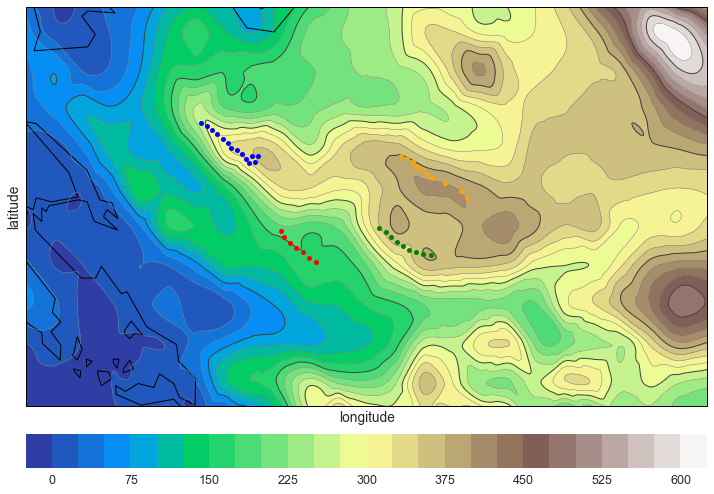

In [47]:
# Basemap plotting of terrain topography (interpolated data from NOAA) 
basemap_plot('merc', X, Y, Z, 30, 'terrain')  # Mercator projection

In [48]:
def colorize(array, cmap='rainbow'):
    normed_data = (array - array.min()) / (array.max() - array.min())
    cm = plt.cm.get_cmap(cmap)
    return cm(normed_data)

colored_data = colorize(Z, cmap='terrain')

In [49]:
# Thunderforrest map tiles show elevation
tileset = r'http://{s}.tile.thunderforest.com/cycle/{z}/{x}/{y}.png'  #Thunderforrest
attribution = '&copy; <a href="http://www.thunderforest.com/">Thunderforest</a>, ' \
              '&copy; <a href="http://www.openstreetmap.org/copyright">OpenStreetMap</a>'
mapa = folium.Map(location=[43.72, 16.05], zoom_start=12, tiles=tileset, attr=attribution)
# Wind farm 1
for key, val in wind_farm_1.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='green')).add_to(mapa)
# Wind farm 2
for key, val in wind_farm_2.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='orange')).add_to(mapa)
# Wind farm 3
for key, val in wind_farm_3.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(color='red', icon='info-sign')).add_to(mapa)
# Wind farm 4
for key, val in wind_farm_4.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(color='blue', icon='info-sign')).add_to(mapa)
# Image overlay (terrain topography)
mapa.image_overlay(np.flipud(colored_data), opacity=0.5, 
                   min_lat=43.6, max_lat=43.8, min_lon=15.85, max_lon=16.25,
                   mercator_project=True)
mapa

In [51]:
# Aggregate neg. and pos. lightning data
lon_cg = np.r_[lon_cg_neg, lon_cg_poz]
lat_cg = np.r_[lat_cg_neg, lat_cg_poz]
amp_cg = np.r_[ampl_neg, ampl_poz]

Recorded geographical locations (latitude and longitude) of each CG lightning strike can be employed for the purpose of obtaining a detailed local distribution density of lightning strikes. This has been tackled using the bivariate kernel density estimation (with Gaussian kernels) in spherical geometry (i.e. using haversine distance), and mapping the ensuing distribution by means of the Mercator projection.

In [52]:
# Kerenel density estimation of lat-lon lightning distribution using scikit-learn
def scikit_bivariate_kde(x, y, bw, algo='auto', kernel='gaussian', metric='euclidean', gridsize=100, cut=3):
    """
    Compute a bivariate PDF using scikit-learn bivariate kde estimation
    If the metric='haversine', kernel='gaussian' and algorithm='ball_tree'
    then the KDE is estimated in spherical coordinates!
    """
    kde = KernelDensity(bandwidth=bw, algorithm=algo,  kernel=kernel, metric=metric)
    xy = np.vstack([x.ravel(), y.ravel()]).T
    kde.fit(xy)
    x_support = kde_support(x, bw, gridsize, cut)
    y_support = kde_support(y, bw, gridsize, cut)
    xx, yy = np.meshgrid(x_support, y_support)
    xxyy = np.vstack([xx.ravel(), yy.ravel()]).T
    zz = np.exp(kde.score_samples(xxyy))
    zz = zz.reshape(xx.shape)
    return xx, yy, zz

def kde_support(data, bw, gridsize=100, cut=3):
    """
    Establish support for a kernel density estimate
    :param data: 1d array of random data
    :param bw: bandwidth size
    :param gridsize: number of points for the support
    :param cut: level at which the support is cut
    :return: 1d array of support values
    """
    support_min = min(data) - bw * cut
    support_max = max(data) + bw * cut
    return np.linspace(support_min, support_max, gridsize)

# The KDE is estimated in spherical coordinates!
bw_x = statistics.bandwidth(lon_cg, weight=None, kernel='Gaussian')
bw_y = statistics.bandwidth(lat_cg, weight=None, kernel='Gaussian')
bw = np.sqrt(bw_x*bw_y)
lon, lat, data = scikit_bivariate_kde(lon_cg, lat_cg, bw=bw, algo='ball_tree', kernel='gaussian', 
                                      metric='haversine', gridsize=100, cut=3)

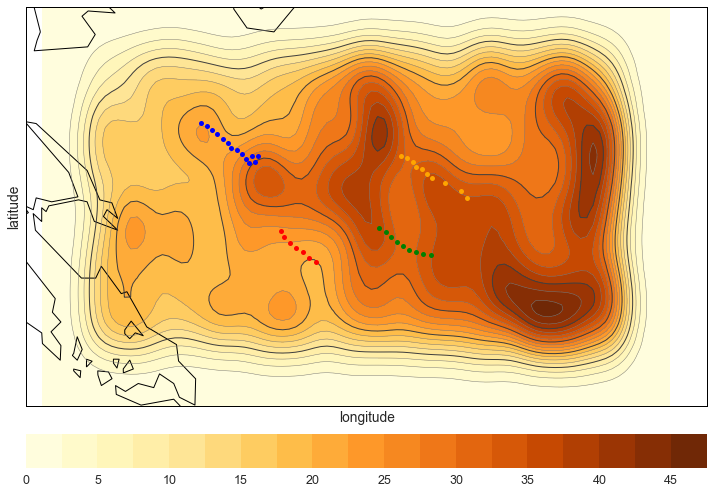

In [53]:
# Basemap plotting of KDE of lightning data lon-lat values
basemap_plot('merc', lon, lat, data, 20, 'YlOrBr')  # Mercator projection

The figure above depicts a geographical distribution of total cloud-to-ground lightning density, obtained from the kernel density estimation of longitude and latitude values of all individual lightning strikes. By comparing this distribution density with the terrain topography it can be seen that the CG lightning denisty distribution closely follows the terrain topology. This is quite remarkable. The higher elevations are associated with denser lightning distribution and vice-versa. 

In [54]:
colored_data = colorize(data, cmap='YlOrBr')

In [55]:
# Folium map of lightning density overlaid on top of Thunderforrest tiles
# Thunderforrest map tiles show elevation
tileset = r'http://{s}.tile.thunderforest.com/cycle/{z}/{x}/{y}.png'  #Thunderforrest
attribution = '&copy; <a href="http://www.thunderforest.com/">Thunderforest</a>, ' \
              '&copy; <a href="http://www.openstreetmap.org/copyright">OpenStreetMap</a>'
mapa = folium.Map(location=[43.72, 16.05], zoom_start=12, tiles=tileset, attr=attribution)
# Wind farm 1
for key, val in wind_farm_1.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='green')).add_to(mapa)
# Wind farm 2
for key, val in wind_farm_2.iteritems():
    folium.Marker(location=[val[0], val[1]], popup=key,
                  icon=folium.Icon(icon='info-sign', color='orange')).add_to(mapa)
# Wind farm 3
for key, val in wind_farm_3.iteritems():
    mapa.simple_marker(location=[val[0], val[1]], popup=key,
                       marker_color='red', marker_icon='info-sign')
# Wind farm 4
for key, val in wind_farm_4.iteritems():
    mapa.simple_marker(location=[val[0], val[1]], popup=key,
                       marker_color='blue', marker_icon='info-sign')
# Image overlay (lightning density)
mapa.image_overlay(np.flipud(colored_data), opacity=0.5, 
                   min_lat=43.6, max_lat=43.8, min_lon=15.85, max_lon=16.25,
                   mercator_project=True)
# Colormap for overlay
color_map = folium.colormap.linear.YlOrBr.scale(data.min(), data.max()).to_step(10)
color_map.caption = 'Lightning strikes ground flash density'
mapa.add_children(color_map)
mapa

In [55]:
# Kerenel density estimation of lat-lon lightning distribution using statsmodels
def statsmodels_bivariate_kde(x, y, bw, gridsize=100, cut=3):
    """
    Compute a bivariate PDF using statsmodels bivariate kde estimation
    :param x: 1d array of random data
    :param y: 1d array of random data
    :param bw: bandwidth size
    :param gridsize: number of points for the support
    :param cut: level at which the support is cut
    :return:  meshgrid x and y values and computed pdf values
    """
    kde = sm.nonparametric.KDEMultivariate([x, y], 'cc', bw)
    x_support = kde_support(x, kde.bw[0], gridsize, cut)
    y_support = kde_support(y, kde.bw[1], gridsize, cut)
    xx, yy = np.meshgrid(x_support, y_support)
    zz = kde.pdf([xx.ravel(), yy.ravel()]).reshape(xx.shape)
    return xx, yy, zz

# Kerenel density estimation of lat-lon lightning PDF using statsmodels
# Optimal bandwidth can be determined from: 'normal_reference' (rule of thumb), 
# 'cv_ml' (cross validation maximum likelihood), or 'cv_ls' (cross validation least squares)
lon, lat, data = statsmodels_bivariate_kde(lon_cg, lat_cg, bw='normal_reference', gridsize=100, cut=3)

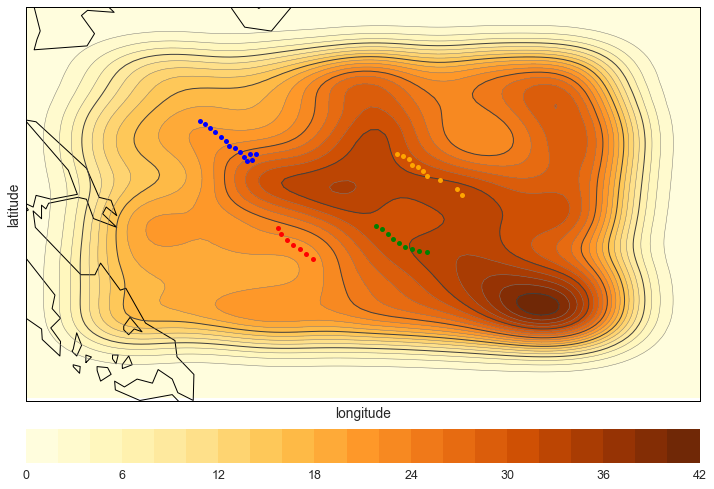

In [56]:
# Basemap plotting of KDE of lightning data lon-lat values
basemap_plot('merc', lon, lat, data, 20, 'YlOrBr')  # Mercator projection

The figure above again depicts a geographical distribution of total cloud-to-ground lightning density, obtained from the kernel density estimation of longitude and latitude values of all individual lightning strikes. It uses euclidian distance measure, Gaussian kernels, and Mercator projection.

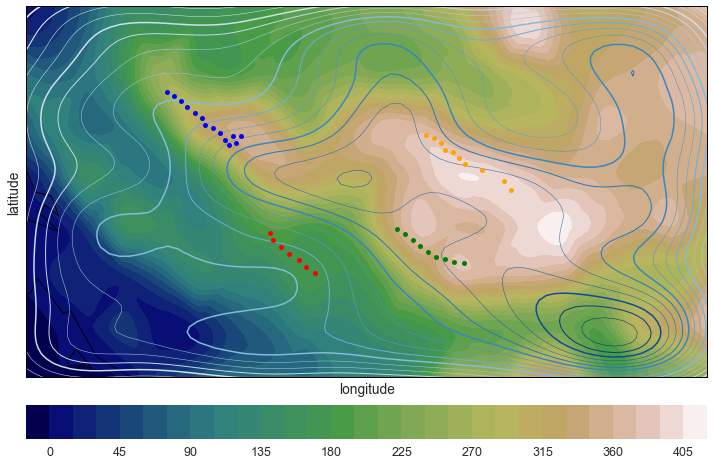

In [57]:
# Basemap *terrain & KDE* of lightning data lon-lat values
fig = plt.figure(figsize=(10, 8))
m = Basemap(projection='merc', ellps='WGS84', lat_0=43.5, lon_0=16, resolution='h', area_thresh=0.1,
            llcrnrlon=lon_cg.min(), llcrnrlat=lat_cg.min(), urcrnrlon=lon_cg.max(), urcrnrlat=lat_cg.max())
m.drawcoastlines()
m.drawcountries()
m.drawmapboundary(fill_color='white')
# Terrain
cs = m.contourf(X, Y, Z, 30, latlon=True, cmap=plt.cm.get_cmap('gist_earth'))
plt.colorbar(cs, orientation='horizontal', pad=0.05)
# Lightning density 
m.contour(lon, lat, data, 20, latlon=True, linewidths=[1.5, 1.0, 0.5, 0.5], 
          cmap=plt.cm.get_cmap('Blues'))
# Wind farm locations
for key, val in wind_farm_1.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='green', markersize=5)
for key, val in wind_farm_2.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='orange', markersize=5)
for key, val in wind_farm_3.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='red', markersize=5)
for key, val in wind_farm_4.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='blue', markersize=5)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.tight_layout()
plt.show()

The figure above superimposes the local terrain topography (color map) with the geographical distribution of total cloud-to-ground lightning density (contour lines).

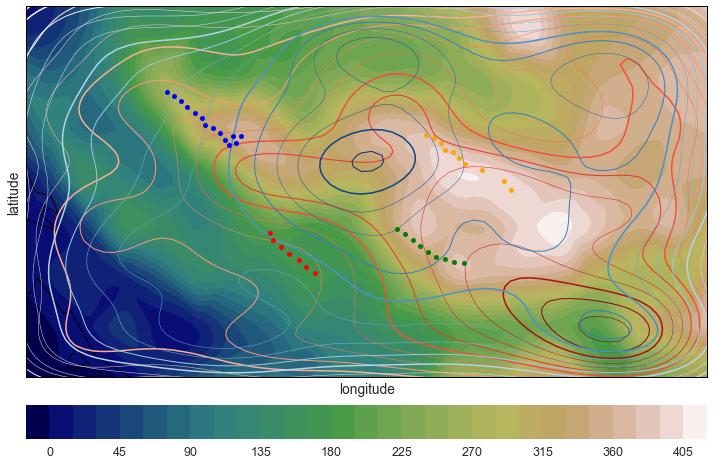

In [58]:
# Kerenel density estimation of CG negative lat-lon lightning PDF using statsmodels
lon_neg, lat_neg, data_neg = statsmodels_bivariate_kde(lon_cg_neg, lat_cg_neg, bw='normal_reference', 
                                                       gridsize=100, cut=3)
# Kerenel density estimation of CG positive lat-lon lightning PDF using statsmodels
lon_poz, lat_poz, data_poz = statsmodels_bivariate_kde(lon_cg_poz, lat_cg_poz, bw='normal_reference', 
                                                       gridsize=100, cut=3)

# Basemap plotting of KDE of lightning data lon-lat values
fig = plt.figure(figsize=(10, 8))
m = Basemap(projection='merc', ellps='WGS84', lat_0=43.5, lon_0=16, resolution='h', area_thresh=0.1,
            llcrnrlon=lon_cg.min(), llcrnrlat=lat_cg.min(), urcrnrlon=lon_cg.max(), urcrnrlat=lat_cg.max())
m.drawcoastlines()
m.drawcountries()
m.drawmapboundary(fill_color='white')
# Terrain
cs = m.contourf(X, Y, Z, 30, latlon=True, cmap=plt.cm.get_cmap('gist_earth'))
plt.colorbar(cs, orientation='horizontal', pad=0.05)
# CG negative lightning density (red contours)
m.contour(lon_neg, lat_neg, data_neg, 15, latlon=True, linewidths=[1.5, 1.0, 0.5, 0.5], 
          cmap=plt.cm.get_cmap('Reds'))
# CG positive lightning density (blue contours)
m.contour(lon_poz, lat_poz, data_poz, 15, latlon=True, linewidths=[1.5, 1.0, 0.5, 0.5], 
          cmap=plt.cm.get_cmap('Blues'))
# Wind farm locations
for key, val in wind_farm_1.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='green', markersize=5)
for key, val in wind_farm_2.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='orange', markersize=5)
for key, val in wind_farm_3.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='red', markersize=5)
for key, val in wind_farm_4.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='blue', markersize=5)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.tight_layout()
plt.show()

The figure above superimposes the local terrain topography (color map) with the geographical distribution of negative (red contour lines) and positive (blue contour lines) cloud-to-ground lightning density.

Number of cluster seeds: 2
lon: 16.059, lat: 43.754
lon: 16.159, lat: 43.676


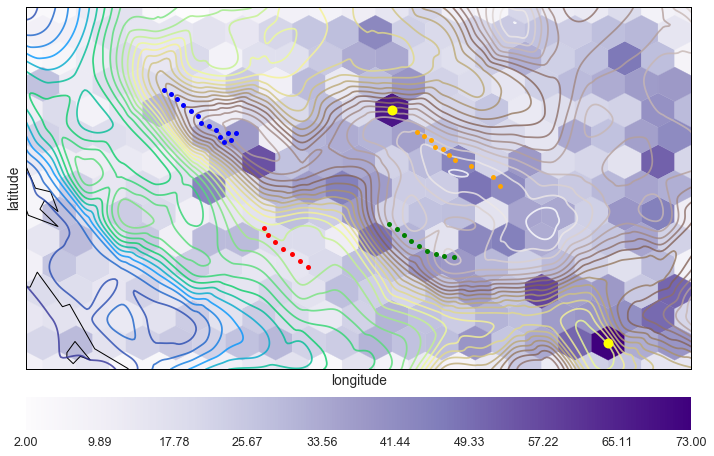

In [59]:
# Basemap *hexbin* plotting of KDE of lightning data
# Using hexbin plot (with each bin of approximately 1km2) one can 
# obtain local ground flash density (no. strikes per km2 per year)
fig = plt.figure(figsize=(10, 8))
m = Basemap(projection='merc', ellps='WGS84', lat_0=43.5, lon_0=16, resolution='h', area_thresh=0.1,
                llcrnrlon=lon_cg.min(), llcrnrlat=lat_cg.min(), urcrnrlon=lon_cg.max(), urcrnrlat=lat_cg.max())
m.drawcoastlines()
m.drawcountries()
m.drawmapboundary(fill_color='white')
numhexbins = 20  # each bin is approximately 1km2
h = m.latmax - m.latmin
w = m.lonmax - m.lonmin
m.contour(X, Y, Z, 30, latlon=True, alpha=0.8, cmap=plt.cm.get_cmap('terrain'))
xlon, ylat = m(lon_cg, lat_cg)  # convert coordinates for hexbin
hb = m.hexbin(xlon, ylat, mincnt=1, alpha=1,
              gridsize=(numhexbins, int(numhexbins*h/w)), 
              cmap=plt.cm.get_cmap('Purples'))
cb = plt.colorbar(hb, orientation='horizontal', pad=0.05)
cb.set_ticks(np.linspace(hb.get_array().min(), hb.get_array().max(), 10))
# Wind farm locations
for key, val in wind_farm_1.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='green', markersize=5)
for key, val in wind_farm_2.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='orange', markersize=5)
for key, val in wind_farm_3.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='red', markersize=5)
for key, val in wind_farm_4.iteritems():
    m.plot(val[1], val[0], latlon=True, marker='o', markerfacecolor='blue', markersize=5)
# Hexagons with highest lightning strike counts
hexdata = hb.get_array()
verts = hb.get_offsets()
mask = np.where(hexdata > 65)  # for example, extract hexbins with strikes > 65
vertices = verts[mask]
no_cluster_seeds = vertices.shape[0]  
# Number and possition of seeds can be used in k-means for finding clusters (see below)
print('Number of cluster seeds: {:g}'.format(no_cluster_seeds))
for row in vertices:
    m.plot(row[0], row[1], marker='o', markerfacecolor='yellow', markersize=10)
    x, y = m(row[0], row[1], inverse=True)
    print('lon: {:,.3f}, lat: {:.3f}'.format(x, y))  # cluster seed positions
plt.xlabel('longitude')
plt.ylabel('latitude')    
plt.tight_layout()
plt.show()

The figure above presents 2D histogram (hexbin) distribution of total cloud-to-ground lightning activity over a geographical region of interest. Using the hexbin plot (with each bin of approximately 1km2) one can obtain local ground flash density (no. strikes per km2 per year). Yellow dots identify by geometry and values those hexbins with high lightning strike counts (taken here > 65 strikes). This number, along with location (lon-lat) of these hexbins, can be used in clustering algorithms for finding flash-cells (see below).

### Simple tracking of thunderstorm development

Lightning activity recorded by LINET can be used for tracking (and even possibly predicting) the development and movement of thunderstorms. With direct access to the LINET servers this could be done in near real-time (large areas need to be monitored due to the extent of thunderstorms). It is based on recognizing the thunderstorm cells (from recorded CG and CC lightning activity) and their temporal evolution and movement. Here, a simple approach to the tracking of thunderstorm development during a single day is demonstrated for the date: 2014-09-01, using this small dataset. See also (above) the diurnal analysis of lightning activity for this day.

In [8]:
date = '2014-09-01'
cg_date = li.groupby('type').get_group(1).ix[date]
cc_date = li.groupby('type').get_group(2).ix[date]
time_frame = [date + ' ' + '0' + str(x) for x in range(1, 10)]
time_frame += [date + ' ' + str(x) for x in range(10, 20)]

# Hourly tracking of thunderstorm development
times = []  # hours
positions = []  # hours integers
for k in range(len(time_frame)):
    # We need some number of strikes within the hour in order to proceed
    if cg_date['ampl'].ix[time_frame[k]].count() > 100:
        print(k, time_frame[k], cg_date['ampl'].ix[time_frame[k]].count())
        positions.append(k)
        times.append(time_frame[k])

1 2014-09-01 02 342
3 2014-09-01 04 152
10 2014-09-01 11 328
11 2014-09-01 12 276


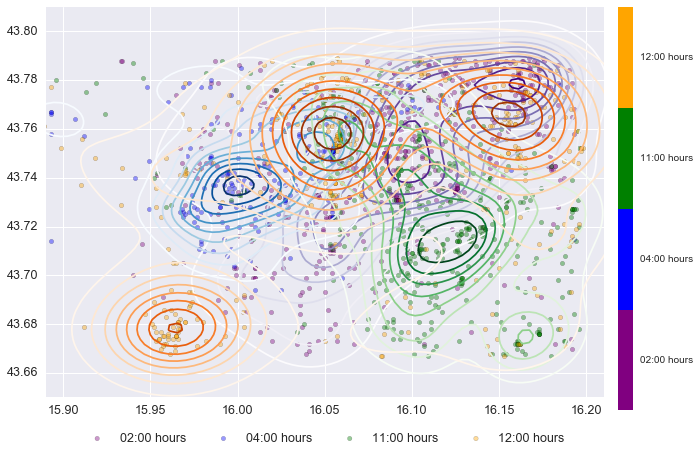

In [9]:
from matplotlib.colors import ListedColormap
from matplotlib.colorbar import ColorbarBase

# There are four hours with intensive lightning activity
labels = [x[-2:]+':00 hours' for x in times]

colours = ['Purple', 'Blue', 'Green', 'Orange']
cmaps = ['Purples', 'Blues', 'Greens', 'Oranges']

# Display of thunderstorm development during the day
fig, ax = plt.subplots(figsize=(10, 7))
for k, t, col, c, lab in zip(positions, times, colours, cmaps, labels):
    lons_cg = cg_date['lon'].ix[time_frame[k]]
    lats_cg = cg_date['lat'].ix[time_frame[k]]
    lons_cc = cc_date['lon'].ix[time_frame[k]]
    lats_cc = cc_date['lat'].ix[time_frame[k]]
    # Aggregate CG and CC lightning
    lons = np.r_[lons_cg, lons_cc]
    lats = np.r_[lats_cg, lats_cc]
    sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=c, ax=ax)  # Seaborn kdeplot
    ax.scatter(lons, lats, s=20, c=col, label=lab, alpha=0.4)
ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.15), ncol=4, fancybox=True)  # legend
# Custom colormap
cmap = ListedColormap(colours)
cax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # colorbar axis
cbar = ColorbarBase(cax, cmap=cmap)
cbar.ax.get_yaxis().set_ticks([])
# Custom colorbar labels
for j, lab in enumerate(labels):
    cbar.ax.text(1.5, (2 * j + 1) / 8.0, lab, ha='left', va='center')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

In [104]:
lons_cg = cg_date['lon'].ix[time_frame[positions[3]]]
lats_cg = cg_date['lat'].ix[time_frame[positions[3]]]
lons_cc = cc_date['lon'].ix[time_frame[positions[3]]]
lats_cc = cc_date['lat'].ix[time_frame[positions[3]]]
# Aggregate CG and CC lightning
lons = np.r_[lons_cg, lons_cc]
lats = np.r_[lats_cg, lats_cc]
X = np.c_[lons, lats]
lab = labels[3]

#### Clustering algorithms from machine learning

In [106]:
# Clustering algorithms from machine learning (scikit-learn)
cluster_method = 'mean-shift'
if cluster_method == 'mean-shift':
    # Compute clustering with MeanShift
    bw = estimate_bandwidth(X, quantile=0.3)
    model = MeanShift(bandwidth=bw, min_bin_freq=10, bin_seeding=True)
    model.fit(X)
    cluster_centers = model.cluster_centers_
    labels = model.labels_
    labels_unique = np.unique(labels)
    n_clusters = len(labels_unique)   
elif cluster_method == 'k-means':
    # Compute clustering with KMeans
    model = KMeans(n_clusters=3)  # no. clusters as input
    model.fit(X)
    cluster_centers = model.cluster_centers_       
    labels = model.labels_
    labels_unique = np.unique(labels)
    n_clusters = len(labels_unique) 
elif cluster_method == 'k-means-mini':
    # Compute clustering with MiniBatchKMeans
    model = MiniBatchKMeans(n_clusters=3)  # no. clusters as input
    model.fit(X)
    cluster_centers = model.cluster_centers_       
    labels = model.labels_
    labels_unique = np.unique(labels)
    n_clusters = len(labels_unique)     
elif cluster_method == 'affinity':
    # Compute clustering using Affinity propagation
    model = AffinityPropagation(damping=0.9, preference=-50)
    model.fit(X)
    cluster_centers_indices = model.cluster_centers_indices_
    n_clusters = len(cluster_centers_indices)
    cluster_centers = model.cluster_centers_
    labels = model.labels_
print('Estimated number of clusters ({:s}): {:g}'.format(cluster_method, n_clusters))

# Silhouette Coefficient analysis
cluster_labels = model.fit_predict(X)
silhouette_avg = silhouette_score(X, cluster_labels)
print('The average Silhouette Coefficient is: {:.4f}'.format(silhouette_avg))

Estimated number of clusters (mean-shift): 3
The average Silhouette Coefficient is: 0.5764


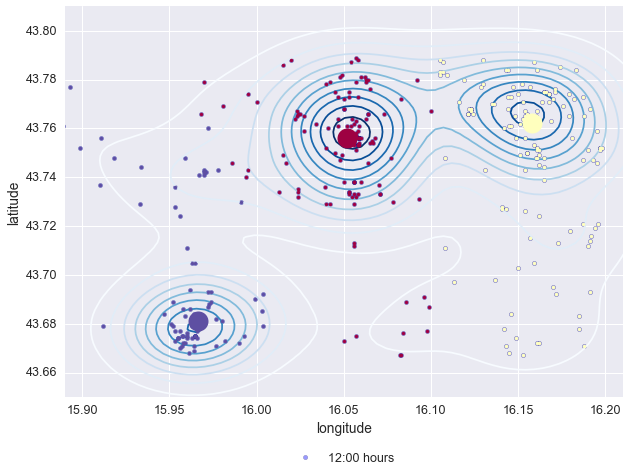

In [12]:
fig, ax = plt.subplots(figsize=(10, 7))
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax)       
ax.scatter(lons, lats, s=20, c='blue', label=lab, alpha=0.4)
colors = plt.cm.Spectral(np.linspace(0, 1, n_clusters))  # generate colours
if n_clusters > 0:
    for k, col in zip(range(n_clusters), colors):
        # Cluster centers
        cluster_center = cluster_centers[k]
        ax.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
                markeredgecolor='black', markersize=20)
        # Cluster members
        members = (labels == k)
        ax.plot(X[members, 0], X[members, 1], '.', c=col)
ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=4, fancybox=True)  # legend
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

Clustering algorithms introduced above will assign *every point* to some of the formed clusters, as can be seen from the figure above. At the same time, it is clear that some of the points are outliers to the formed clusters. It would be appreciated if these points could be removed and clusters formed only from tightly packed points. The distance metric can be used as a measure for detecting and removing these outliers. This has been demonstrated for one of the clusters in the following figure.

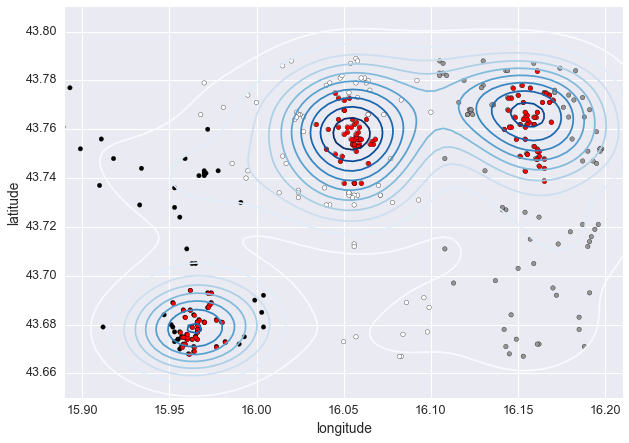

In [75]:
# Mahalanobis distance metric for cluster outlier detection
q = 75  # percentile of Chi-2 distribution for treshold
fig, ax = plt.subplots(figsize=(10, 7))
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax)
ax.scatter(X[:,0], X[:,1], s=20, c=labels)
for k in range(n_clusters):
    members = (labels == k)
    cc = cluster_centers[k]
    X_masked = X[members]
    # Points in cluster far away from the cluster center will be removed
    dist = pairwise.pairwise_distances(X_masked, cc, metric='mahalanobis')
    d2 = dist**2
    # Treshold can be defined using Chi-2 distribution
    treshold = stats.chi2.ppf(1-q/100., 2)
    X_group = X_masked[np.where(d2<treshold)[0]]
    ax.scatter(X_group[:,0], X_group[:,1], s=20, c='red')  # red points retained
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

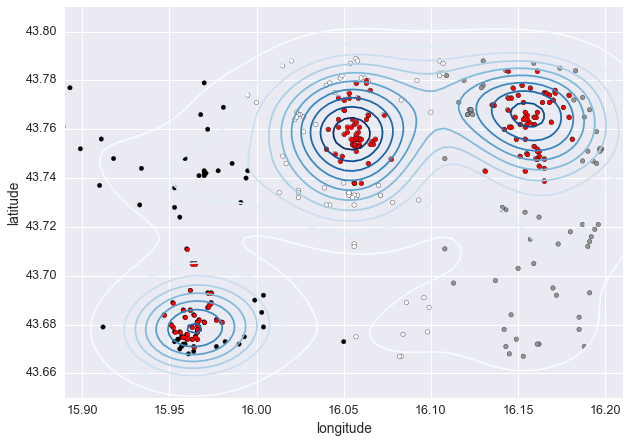

In [111]:
# Removing outlier data points from the clusters
q = 50  # percentile of the euclidean distance distribution for treshold
fig, ax = plt.subplots(figsize=(10, 7))
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax)
ax.scatter(X[:,0], X[:,1], s=20, c=labels)
# cluster labels = 0, 1, 2 for three clusters
for k in range(n_clusters):
    members = (labels == k)
    cc = cluster_centers[k]
    X_masked = X[members]
    # Points in cluster far away from the cluster center will be removed
    dist_eucl = pairwise.pairwise_distances(X_masked, cc, metric='euclidean')
    # Treshold can be defined as the q-th percentile of the distance distribution
    treshold = np.percentile(dist_eucl, q)
    X_group = X_masked[np.where(dist_eucl<treshold)[0]]
    ax.scatter(X_group[:,0], X_group[:,1], s=20, c='red')  # red points retained
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

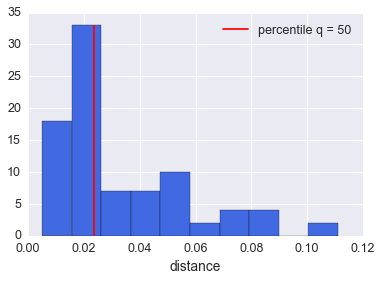

In [112]:
# Example of the distance distribution and percentile level
ret, bs, pat = plt.hist(dist_eucl, color='royalblue')
plt.vlines(treshold, 0, ret.max(), color='red', label='percentile q = {:g}'.format(q))
plt.legend(loc='best')
plt.xlabel('distance')
plt.show()

In [113]:
idx = np.abs(dist_eucl-treshold).argmin()
print('Distance at selected percentile: {:g}'.format(dist_eucl[idx][0]))

Distance at selected percentile: 0.0234252


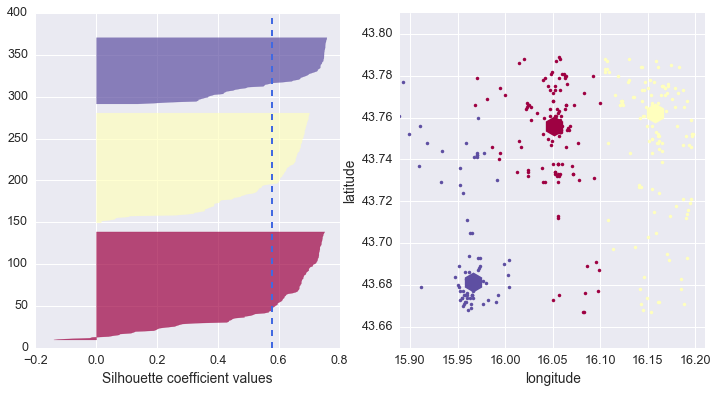

In [67]:
# Silhouette analysis of the number of clusters
# http://scikit-learn.org/stable/auto_examples/
# cluster/plot_kmeans_silhouette_analysis.html
# #example-cluster-plot-kmeans-silhouette-analysis-py
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
colors = plt.cm.Spectral(np.linspace(0, 1, n_clusters))  # generate colours
if n_clusters > 0:
    y_lower = 10
    for k, col in zip(range(n_clusters), colors):
        
        silhouette_values = silhouette_samples(X, cluster_labels)
        # Aggregate the silhouette scores for samples belonging to
        # each cluster and sort them
        ith_cluster_silhouette_values = silhouette_values[cluster_labels == k]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=col, edgecolor=col, alpha=0.7)
        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

        # Cluster centers
        cluster_center = cluster_centers[k]
        ax2.plot(cluster_center[0], cluster_center[1], marker='h', markerfacecolor=col,
                markeredgecolor='black', markersize=20)
        # Cluster members
        members = (labels == k)
        ax2.plot(X[members, 0], X[members, 1], '.', c=col)
# The vertical line for average silhoutte score of all the values
ax1.axvline(x=silhouette_avg, color="royalblue", linestyle="--", lw=2)
ax1.set_xlabel("Silhouette coefficient values")
ax2.set_xlabel('longitude')
ax2.set_ylabel('latitude')
ax2.set_xlim(15.89, 16.21)
ax2.set_ylim(43.65, 43.81)
plt.show()

Silhouette analysis can be used to study the separation distance between the resulting clusters. Silhoette coefficients are in the range of [-1, 1], where the values near +1 indicate that the sample is far away from the neighboring clusters. A value of 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters and negative values indicate that those samples might have been assigned to the wrong cluster. The thickness of the silhouette plot determines the cluster size. The Silhouette Coefficient for a set of samples is given as the mean of the Silhouette Coefficient for each sample, where a higher Silhouette Coefficient score relates to a model with better defined clusters. 

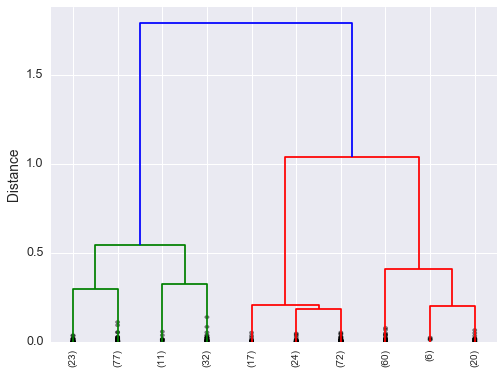

In [68]:
# Hierarchical clustering using Scipy
z_d = linkage(X, method='ward', metric='euclidean')
fig, ax = plt.subplots(figsize=(8, 6))
# Visualizing dendrogram
dendrogram(z_d, p=10, truncate_mode='lastp', leaf_rotation=90, 
               leaf_font_size=10, show_contracted=True, ax=ax)
ax.set_ylabel('Distance')
plt.show()

Usually thunderstorms behave differently depending on the scale of analysis: individual cells generally move in several directions while the whole convective system moves in one preferred direction. Thus, using the hierarchical clustering, the tracking of convective systems may be carried out on different levels. Dendrogram can be used to estimate the optimal number of clusters in hierarchical clustering.

No. clusters: 3


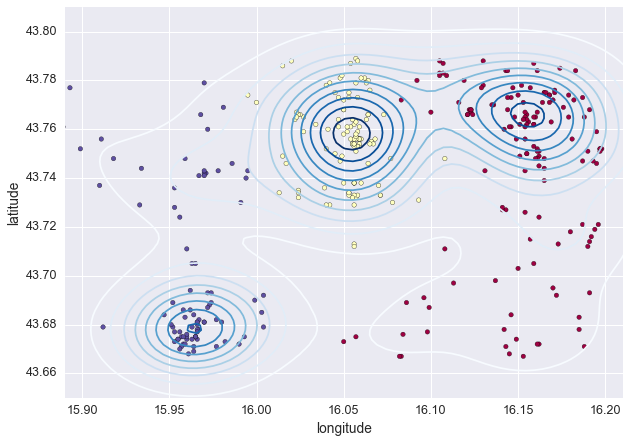

In [69]:
# Define clusters from distance metric 
max_dist = 0.7  # from dendrogram
clusters = fcluster(z_d, max_dist, criterion='distance')
# No. of clusters
n_clusters = len(np.unique(clusters))
print('No. clusters: {:d}'.format(n_clusters))

# Visualize clusters
fig, ax = plt.subplots(figsize=(10, 7))
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax)
ax.scatter(X[:,0], X[:,1], s=20, c=clusters, cmap=plt.cm.Spectral)
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

From the centers of clusters, as identified by the kernel density estimation and machine learning algorithm, the thunderstorm cells can be formed and temporal-evolution of their movement tracked. The method for cell tracking searches for event clusters and defines the border of a cell by means of the stroke density. A cell is suspected when the number of strokes per area surpasses a set minimum, and likewise the border is recognized when the absolute stroke number falls below this minimum. For each recognised cell area, a polygon can be drawn which serves to visually identify the thunderstorm cell.

Estimated number of clusters (DBSCAN): 3


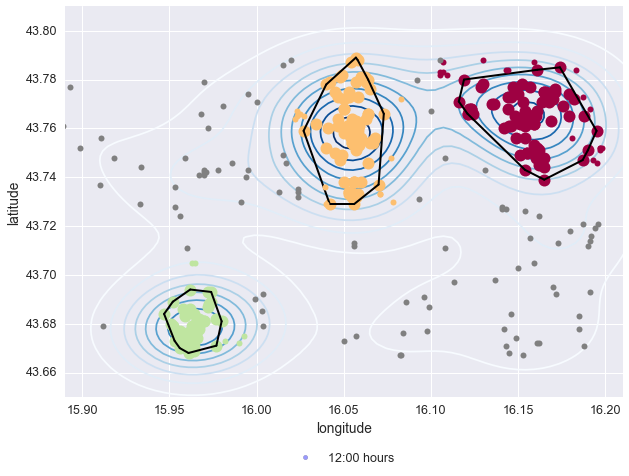

In [101]:
precomputed = True
# Compute DBSCAN - Density-Based Spatial Clustering of Applications with Noise
if precomputed:
    A = radius_neighbors_graph(X, radius=0.015, mode='distance')
    db = DBSCAN(min_samples=10, metric='precomputed')
    db.fit(A)
else:
    db = DBSCAN(eps=0.015, min_samples=10)
    db.fit(X)
    
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print('Estimated number of clusters (DBSCAN): {:g}'.format(n_clusters_))

fig, ax = plt.subplots(figsize=(10, 7))
ax.scatter(lons, lats, s=20, c='blue', label=lab, alpha=0.4)
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax)
unique_labels = set(labels)
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))  # generate colours
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Grey used for noise.
        col = 'grey'
    class_member_mask = (labels == k)
    # Class members
    xy = X[class_member_mask & core_samples_mask]
    ax.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
            markeredgecolor='k', markersize=12)
    # Flash-cell poligon can be created using convex hull with the cluster points
    # Convex hull is the smallest convex object containing all points in a given point set
    if k != -1:  # for clusters only
        cluster_points = xy
        hull = spatial.ConvexHull(xy)
        for simplex in hull.simplices:
            ax.plot(cluster_points[simplex,0], cluster_points[simplex,1], c='k', ls='-', lw=2)    
    # Not in the class
    xy = X[class_member_mask & ~core_samples_mask]
    ax.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
            markeredgecolor='k', markersize=6)
ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=4, fancybox=True)  # legend
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

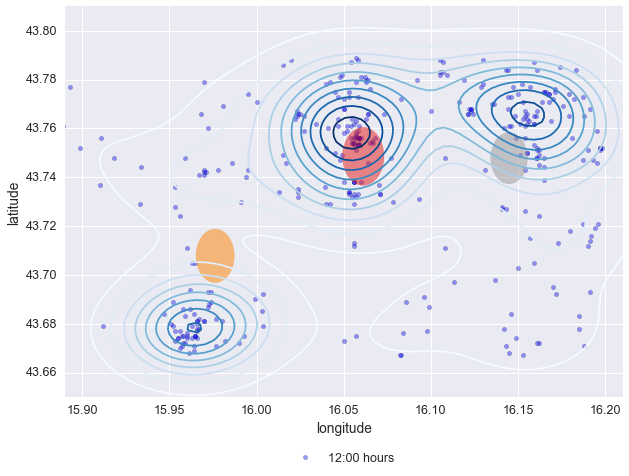

In [71]:
# Gaussian Mixture Model for clustering analysis
# Function adapted from the scikit-learn documentation
def make_ellipses(gmm, ax):
    colors = plt.cm.Set1(np.linspace(0, 1, len(gmm.weights_)))
    for n, color in zip(range(len(gmm.weights_)), colors):
        v, w = np.linalg.eigh(gmm._get_covars()[n][:2, :2])
        u = w[0] / np.linalg.norm(w[0])
        angle = np.arctan2(u[1], u[0])
        angle = 180 * angle / np.pi  # convert to degrees
        v *= 9
        ell = mpl.patches.Ellipse(gmm.means_[n, :2], v[0], v[1],
                                  180 + angle, color=color)
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)

# Gaussian Mixture Model
model = GMM(n_components=3, covariance_type='spherical')  # no. clusters as input
model.fit(X)

fig, ax = plt.subplots(figsize=(10, 7))
ax.scatter(lons, lats, s=20, c='blue', label=lab, alpha=0.4)
sns.kdeplot(lons, lats, shade=False, shade_lowest=False, cmap=plt.cm.get_cmap('Blues'), ax=ax) 
make_ellipses(model, ax)  # GMM
ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=4, fancybox=True)  # legend
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
plt.show()

Mean Shift, Affinity Propagation and DBSCAN clustering algorithms don't need the number of clusters as input parameter; they can determine it. On the other hand, k-means and GMM need the number of clusters in advance. This disadvantage can be aleviated to some degree using several techniques.

### Simple tracking of lightning cluster movement

In [127]:
# Tracking thunderstorm movement using clustering algorithm
selection = time_frame[positions[0]]
lons_cg = cg_date['lon'].ix[selection]
lats_cg = cg_date['lat'].ix[selection]
lons_cc = cc_date['lon'].ix[selection]
lats_cc = cc_date['lat'].ix[selection]
# Aggregate CG and CC lightning
lons = np.r_[lons_cg, lons_cc]
lats = np.r_[lats_cg, lats_cc]
X = np.c_[lons, lats]

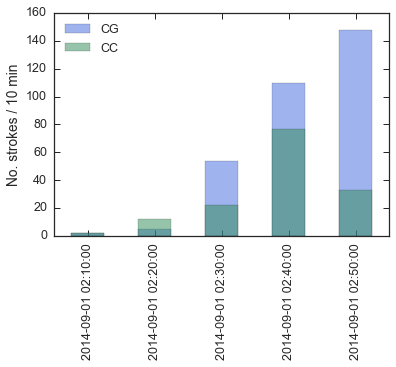

In [129]:
# CG lightning activity in 10 min. intervals
plt.figure(figsize=(6,4))
lons_cg.resample('10min', how='count').dropna().plot(kind='bar', color='royalblue', label='CG', alpha=0.5)
lons_cc.resample('10min', how='count').dropna().plot(kind='bar', color='seagreen', label='CC', alpha=0.5)
plt.legend(loc='best')
plt.ylabel('No. strokes / 10 min')
plt.show()

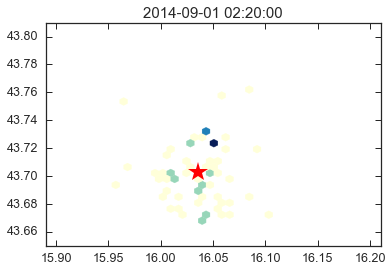

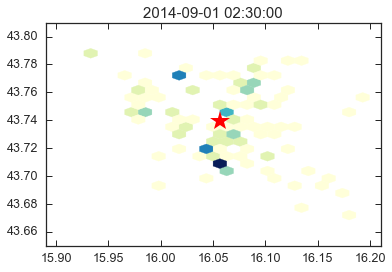

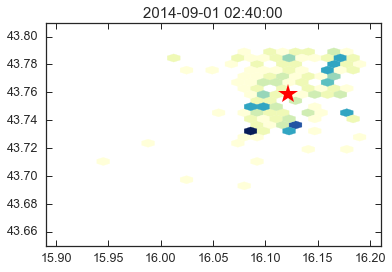

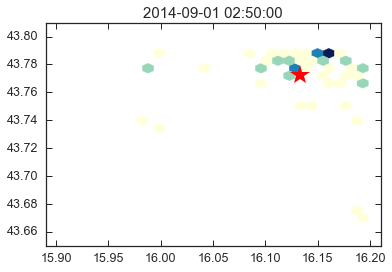

In [132]:
center_x = []
center_y = []
time_var = []
mins = pd.date_range(start=selection, periods=7, freq='10min')
for k in range(len(mins)-1):
    lons_ = lons_cg.ix[mins[k]:mins[k+1]]
    lats_ = lats_cg.ix[mins[k]:mins[k+1]]
    lons_ic = lons_cc.ix[mins[k]:mins[k+1]]
    lats_ic = lats_cc.ix[mins[k]:mins[k+1]]
    lons_all = np.r_[lons_, lons_ic]
    lats_all = np.r_[lats_, lats_ic]
    X = np.c_[lons_all, lats_all]
    if len(lons_all) > 10:  # need some data points
        plt.figure(figsize=(6,4))
        plt.hexbin(lons_all, lats_all, gridsize=20, mincnt=1, cmap=plt.cm.get_cmap('YlGnBu'))
        # Compute clustering with MiniBatchKMeans
        model = MiniBatchKMeans(n_clusters=1)  # only one cluster
        model.fit(X)
        # Cluster centers
        cluster_centers = model.cluster_centers_  
        # Red star indicates cluster center
        plt.plot(cluster_centers[0][0], cluster_centers[0][1], '*', markerfacecolor='red',
                 markeredgecolor='black', markersize=20)
        center_x.append(cluster_centers[0][0])
        center_y.append(cluster_centers[0][1])
        time_var.append(mins[k])
        plt.title(str(mins[k]))
        plt.xlim(15.89, 16.21)
        plt.ylim(43.65, 43.81)
        plt.show()

In [133]:
for k in range(len(mins)-1):
    lons_ = lons_cg.ix[mins[k]:mins[k+1]]
    lats_ = lats_cg.ix[mins[k]:mins[k+1]]
    lons_ic = lons_cc.ix[mins[k]:mins[k+1]]
    lats_ic = lats_cc.ix[mins[k]:mins[k+1]]
    lons_all = np.r_[lons_, lons_ic]
    lats_all = np.r_[lats_, lats_ic]
    X = np.c_[lons_all, lats_all]
    if len(lons_all) > 10:  # need some data points
        # Compute DBSCAN - Density-Based Spatial Clustering of Applications with Noise
        db = DBSCAN(eps=0.02, min_samples=5)  # tuning parameters
        db.fit(X)

        core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
        core_samples_mask[db.core_sample_indices_] = True
        labels = db.labels_
        n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
        #print('Estimated number of clusters (DBSCAN): {:g}'.format(n_clusters_))

        unique_labels = set(labels)
        colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_labels)))  # generate colours
        for ki, col in zip(unique_labels, colors):
            if ki == -1:
                # Grey used for noise.
                col = 'grey'
            class_member_mask = (labels == ki)
            # Class members
            xy = X[class_member_mask & core_samples_mask]
            #plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
            #         markeredgecolor='k', markersize=12)
            
            # Flash-cell poligon can be created using convex hull with the cluster points
            # Convex hull is the smallest convex object containing all points in a given point set
            if ki != -1:  # for clusters only
                cluster_points = xy
                hull = spatial.ConvexHull(xy)
                # Pickle hull data
                with open('hulls_{:d}.p'.format(k), 'wb') as file_pointer:
                    pickle.dump(hull, file_pointer)
                # Draw convex hull
                #for simplex in hull.simplices:
                #    plt.plot(cluster_points[simplex,0], cluster_points[simplex,1], c='k', ls='-', lw=2)  
                    
            # Not in the class
            xy = X[class_member_mask & ~core_samples_mask]
            #plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=col,
            #        markeredgecolor='k', markersize=6)
        
        #plt.title(str(mins[k]))
        #plt.xlim(15.89, 16.21)
        #plt.ylim(43.65, 43.81)
        #plt.show()

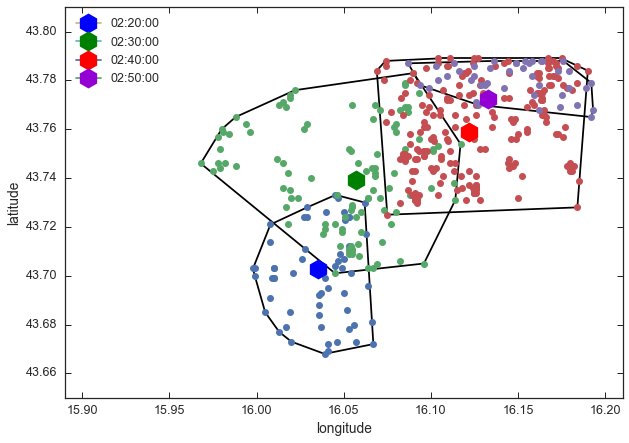

In [134]:
fig, ax = plt.subplots(figsize=(10,7))
# Convex hulls from flash-cell identification
hull_points = True
colors = ['blue', 'green', 'red', 'darkviolet']
for h, c in zip(np.arange(2, 6, 1), colors):
    with open('hulls_{:d}.p'.format(h), 'rb') as file_pointer:
        hull = pickle.load(file_pointer)
    if hull_points:
        # Show the convex hull with points
        spatial.convex_hull_plot_2d(hull, ax=ax)
    else:
        # Show the convex hull only
        for simplex in hull.simplices:
            ax.plot(hull.points[simplex,0], hull.points[simplex,1], color=c)
# Cluster centers from the KMeans algorithm
for x, y, t, c in zip(center_x, center_y, time_var, colors):
    ax.plot(x, y, marker='h', markerfacecolor=c, markeredgecolor='black', 
            markersize=20, label=str(t.time()))
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
ax.legend(loc='best')
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
plt.show()

Convex hull, defined from cluster points, can be converted into the Polygon using the Shapely library http://toblerity.org/shapely/project.html Then, that polygon data can be transformed (exported) into the GeoJson format http://geojson.org/ and graphically presented in folium.

In [77]:
# Convex hulls on a folium map
mapa = folium.Map(location=[43.75, 16.0], zoom_start=11)
for h in np.arange(2, 6, 1):
    with open('hulls_{:d}.p'.format(h), 'rb') as fp:
        hull = pickle.load(fp)
    poly = geometry.Polygon(hull.points[hull.vertices])
    geo_poly = geometry.mapping(poly)
    folium.GeoJson(geo_poly).add_to(mapa)
mapa

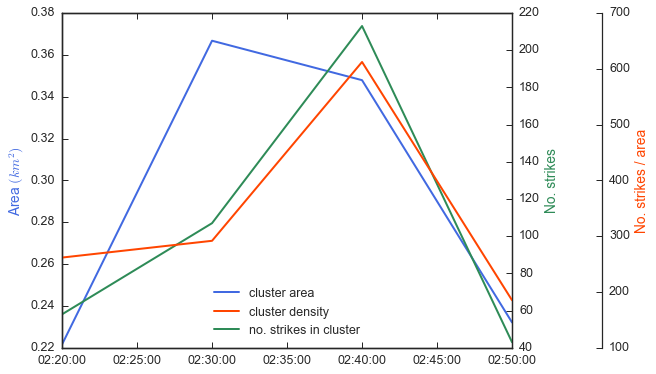

In [135]:
area = []
no_points = []
for h in np.arange(2, 6, 1):
    with open('hulls_{:d}.p'.format(h), 'rb') as file_pointer:
        hull = pickle.load(file_pointer)
        area.append(hull.area)
        no_points.append(hull.points.shape[0])

dens = [p/a for a, p in zip(area, no_points)]

# Redefine Seaborn style for this figure
sns.set(context='notebook', style='whitegrid', font_scale=1.25)
sns.set_style('ticks', {'xtick.direction':'in', 'ytick.direction':'in'})

fig, ax = plt.subplots(figsize=(10,6))
r_ax = ax.twinx()
r2_ax = ax.twinx()
fig.subplots_adjust(right=0.75)
r2_ax.spines['right'].set_position(('axes', 1.2))
l1 = ax.plot(time_var, area, c='royalblue', ls='-', lw=2, label='cluster area')
l2 = r2_ax.plot(time_var, dens, c='orangered', ls='-', lw=2, label='cluster density')
l3 = r_ax.plot(time_var, no_points, c='seagreen', ls='-', lw=2, label='no. strikes in cluster')
ax.set_ylabel('Area '+r'$(km^2)$', color='royalblue')
r2_ax.set_ylabel('No. strikes / area', color='orangered')
r_ax.set_ylabel('No. strikes', color='seagreen')
lns = l1+l2+l3
labs = [l.get_label() for l in lns]
ax.legend(lns, labs, loc='best')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
plt.show()

# Redefine Seaborn style (for subsequent figures)
sns.set(context='notebook', style='darkgrid', font_scale=1.25)

Shapely library can be used for all kinds of shape and polygon manipulations, including translation, analysis of shape overlappings, unions, and intersections. This can be usefull in identifying flass-cell merge and split conditions.

In [79]:
color_func = lambda x: {'fillColor': 'white'}
color_func2 = lambda x: {'fillColor': 'white', 'color':'red'}

mapa = folium.Map(location=[43.75, 16.0], zoom_start=11)
with open('hulls_2.p', 'rb') as fp:
    hull = pickle.load(fp)
# Polygon from convex hull
poly = geometry.Polygon(hull.points[hull.vertices])
geo_poly = geometry.mapping(poly)
folium.GeoJson(geo_poly).add_to(mapa)
# Translating polygon (imitate nowcasting)
offset_x = center_x[1] - center_x[0]
offset_y = center_y[1] - center_y[0]
translate = affinity.translate(poly, xoff=offset_x, yoff=offset_y)
transl_geo = geometry.mapping(translate)
folium.GeoJson(transl_geo, style_function=color_func).add_to(mapa)
# Another translation
trans_more =  affinity.translate(translate, xoff=offset_x, yoff=offset_y)
trans_more_geo = geometry.mapping(trans_more)
folium.GeoJson(trans_more_geo, style_function=color_func).add_to(mapa)
mapa

In [80]:
# Terrain topography
with open('etopo1_bedrock.xyz', 'r') as fp:
    x, y, z = np.loadtxt(fp, unpack=True)
# Cubic interpolation of data 
xi = np.linspace(x.min(), x.max(), 400)
yi = np.linspace(y.min(), y.max(), 400)
XT, YT = np.meshgrid(xi, yi)
ZT = interpolate.griddata((x, y), z, (XT, YT), method='cubic')

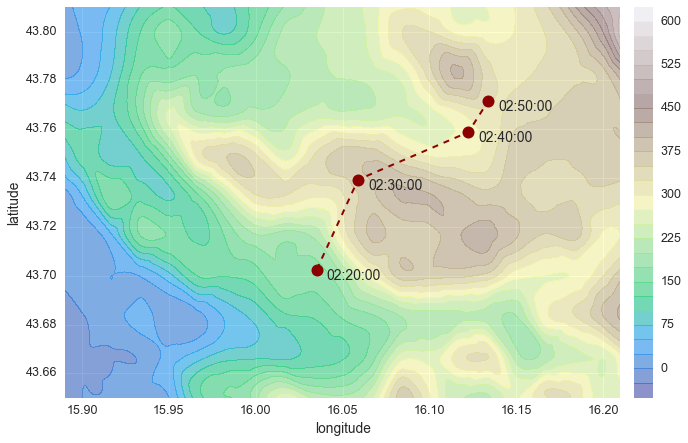

In [81]:
# Path of the lightning cluster movement
fig, ax = plt.subplots(figsize=(12,7))
cs = ax.contourf(XT, YT, ZT, 30, cmap=plt.cm.get_cmap('terrain'), alpha=0.5)
plt.colorbar(cs, orientation='vertical', pad=0.02)
ax.plot(center_x, center_y, color='darkred', ls='--', lw=2, marker='o', markersize=12)
for t, x, y in zip(time_var, center_x, center_y):
    ax.annotate(str(t.time()), xy=(x, y), xycoords='data', 
                 xytext=(10, -10), textcoords='offset points', size=14)
ax.set_xlim(15.89, 16.21)
ax.set_ylim(43.65, 43.81)
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
plt.show()

### Simple nowcasting of lightning cluster position

Using the Haversine distance between cluster centers and time interval (10 minutes) a speed of cluster movement can be determined for each successive time step. Using the Weighted Least Squares Analysis with several (four or more) time steps, a general direction of the cluster movement can be establised (including confidence and prediction levels). Weights are determined in such a manner as to favor the latest time-instance positions and cluster speeds. Nowcasting establishes probable location of the cluster center (after the next 10 minute interval) using the weighted average speed and weighted average angle of cluster center movement between succesive time instances.

In [82]:
delta = 10.  # 10 min. interval

# Great circle distance between points
def distance(lon_wt, lat_wt, lon_rad, lat_rad):
    # Compute a great circle distance between two points on the globe
    distance = 2.*np.arcsin(np.sqrt((np.sin((lat_wt-lat_rad)/2.))**2 +
                                    np.cos(lat_wt)*np.cos(lat_rad) *
                                    (np.sin((lon_wt-lon_rad)/2.))**2))
    return distance

# Angle (true course) between points
def true_angle(lon_wt, lat_wt, lon_rad, lat_rad):
    tc1 = np.mod(np.arctan2(np.sin(lon_wt-lon_rad)*np.cos(lat_rad),
                 np.cos(lat_wt)*np.sin(lat_rad)-np.sin(lat_wt) *
                 np.cos(lat_rad)*np.cos(lon_wt-lon_rad)), 2*np.pi)
    return tc1

v = []  # speed
d = []  # distance
alpha = []  # angle
# Geometrical space
geometry_space = 'haversine'
if geometry_space == 'euclid':
    # Euclidean geometry
    for i in range(len(time_var)-1):
        dist = np.sqrt((center_x[i]-center_x[i+1])**2 + (center_y[i]-center_y[i+1])**2)
        d.append(dist)
        v.append(dist/delta)
        angle = np.arctan2(abs(center_y[i]-center_y[i+1]),
                           abs(center_x[i]-center_x[i+1]))*180./np.pi
        alpha.append(angle)
elif geometry_space == 'haversine':
    # Spherical geometry (Haversine distance)
    for i in range(len(time_var)-1):
        dist = distance(center_x[i], center_y[i], center_x[i+1], center_y[i+1])
        d.append(dist)
        v.append(dist/delta)
        angle = true_angle(center_x[i], center_y[i], center_x[i+1], center_y[i+1])
        angle = angle*180./np.pi - 270.  # reference frame adjustment
        alpha.append(angle)

In [83]:
# Weights for the WLS analysis
w = np.arange(0, len(center_x)+1, 1)
w = w[::-1]  # invert order
weight = '1/x'
if weight == '1/x':
    w = 1./w
    w = w[:-1]
elif weight == '0.5**x':
    w = 0.5**w
    w = w[1:]
elif weight == 'exp':
    w = np.exp(-w)
    w = w[1:]

In [84]:
# average speed and distance covered (weighted)
v_m = np.average(v, weights=w[1:])
v_std = np.sqrt(np.average((v-v_m)**2, weights=w[1:]))
d_m = v_m*delta  # distance from speed
d_mean = np.average(d, weights=w[1:])
d_std = np.sqrt(np.average((d-d_mean)**2, weights=w[1:]))

# average angle (weighted)
a_mean = np.average(alpha, weights=w[1:])
a_std = np.sqrt(np.average((alpha-a_mean)**2, weights=w[1:]))
a_min = a_mean - 2.*a_std
a_max = a_mean + 2.*a_std

In [85]:
# Statsmodels Linear Regression using Weighted Least Squares (WLS) Analysis 
X = np.c_[np.ones(len(center_x)), center_x]
y = center_y
# WLS model
model_ols = sm.WLS(y, X, weights=w)    # notice the order of the endog and exog variables
res_ols = model_ols.fit()
res_ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.911
Model:                            WLS   Adj. R-squared:                  0.867
Method:                 Least Squares   F-statistic:                     20.55
Date:                Fri, 08 Apr 2016   Prob (F-statistic):             0.0454
Time:                        11:14:24   Log-Likelihood:                 14.076
No. Observations:                   4   AIC:                            -24.15
Df Residuals:                       2   BIC:                            -25.38
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [95.0% Conf. Int.]
------------------------------------------------------------------------------
const         34.5087      2.040     16.918      0.003        25.732    43.285
x1             0.5740      0.127      4.533      0.045         0.029     1.119
==============================================================================
Omnibus:                          nan   Durbin-Watson:                   3.099
Prob(Omnibus):                    nan   Jarque-Bera (JB):                0.412
Skew:                           0.418   Prob(JB):                        0.814
Kurtosis:                       1.668   Cond. No.                     6.98e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.98e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [86]:
# New data for the prediction
support = np.linspace(16.0, 16.25, 50)
xnew = np.c_[np.ones(support.size), support]  # must be a 2D array
out_ols = res_ols.predict(xnew)

In [87]:
# Confidance intervals for WLS using bootstrap method
alpha = 0.05  # 95% confidence interval
n_boot = 1000  # No. of bootstrap samples

y_hat = res_ols.fittedvalues  # fittedvalues = np.dot(exog, params)
residuals = res_ols.resid  # residuals = endog - fittedvalues

values = []
# Bootstrap
for i in range(n_boot):
    resid_boot = np.random.choice(residuals, size=len(residuals), replace=True)
    yboot = y_hat + resid_boot
    model_boot = sm.OLS(yboot, X)
    res_boot = model_boot.fit()
    # Prediction values
    out_boot = res_boot.predict(xnew)
    values.append(out_boot)
values = np.asarray(values)

# Means and standard deviations of predicted values
means = np.mean(values, axis=0)
stds = np.std(values, axis=0)

ql = (alpha/2)*100.
qh = (1 - alpha/2)*100.
ci_lows = np.percentile(values, ql, axis=0, interpolation='midpoint')
ci_higs = np.percentile(values, qh, axis=0, interpolation='midpoint')

In [88]:
# Computing prediction intervals from WLS regression
prstd, iv_l, iv_u = wls_prediction_std(res_ols, exog=xnew, alpha=0.05)  # notice the exog parameter

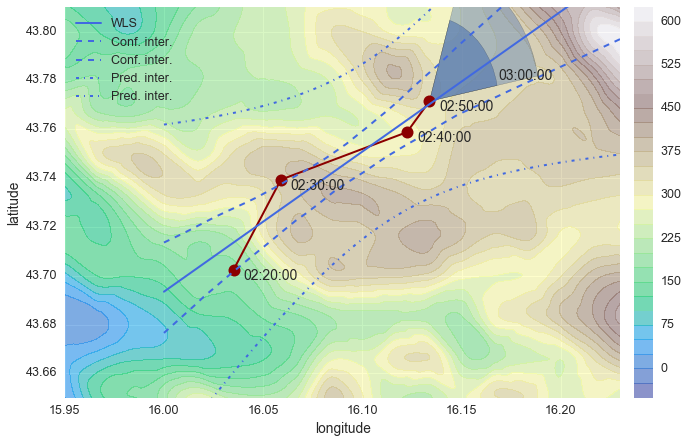

In [89]:
import matplotlib.patches as patches

# Nowcasting flash-cell position
future = time_var[-1] + dt.timedelta(minutes=10)

fig, ax = plt.subplots(figsize=(12,7))
cs = ax.contourf(XT, YT, ZT, 30, cmap=plt.cm.get_cmap('terrain'), alpha=0.5)
plt.colorbar(cs, orientation='vertical', pad=0.02)
ax.plot(center_x, center_y, color='darkred', ls='-', lw=2, marker='o', markersize=12)
for t, x, y in zip(time_var, center_x, center_y):
    ax.annotate(str(t.time()), xy=(x, y), xycoords='data', 
                 xytext=(10, -10), textcoords='offset points', size=14)
# Dark Wedge defines a probable area of finding the cluster center 
ax.add_patch(patches.Wedge((center_x[-1], center_y[-1]), d_mean, a_min, a_max, alpha=0.6))
# Light Wedge accounts for the weighted standard deviation of the prediction
ax.add_patch(patches.Wedge((center_x[-1], center_y[-1]), d_mean+d_std, a_min, a_max, alpha=0.4))
ax.annotate(future.time(), xy=(center_x[-1]+d_m, center_y[-1]+d_m/4), xycoords='data', 
            xytext=(0, 0), textcoords='offset points', size=14)
ax.plot(support, out_ols, c='royalblue', ls='-', lw=2, label='WLS')
ax.plot(support, ci_lows, c='royalblue', ls='--', lw=2, label='Conf. inter.')
ax.plot(support, ci_higs, c='royalblue', ls='--', lw=2, label='Conf. inter.')
ax.plot(support, iv_l, c='royalblue', ls='-.', lw=2, label='Pred. inter.')
ax.plot(support, iv_u, c='royalblue', ls='-.', lw=2, label='Pred. inter.')
ax.legend(loc='best')
ax.set_xlim(15.95, 16.23)
ax.set_ylim(43.65, 43.81)
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
plt.show()

### Wind farm lightning incidence

Computing wind farm lightning incidence by utilising the "effective height", along with the "attractive radius" and "striking distance" concepts of lightning attractiveness of exposed structures. The effective height of free-standing tower is seen as the height of an equivalent (i.e. fictitious) tower on a flat ground that exhibits the same lightning attractiveness as the actual tower. The striking distance is defined as the distance between the object to be struck and the tip of the downward-moving leader, at the instant that the connecting (upward) leader is initiated from the object; it depends on the lightning-current amplitude alone. On the other hand, attractive radius, besides amplitude, takes into account the geometry of the object to be struck (i.e. height). By employing the attractive radius or striking distance concepts, one can compute the "attractive area" of the structure to lightning. This is the area at the ground level which would exhibit the same lightning incidence as the actual structure.

In [90]:
# Wind turbine effective height (on a hilltop)
def effective_height(h, a):
    """
    :param h: wind turbine height (m) as hub height + blade length
    :param a: hemispherical mountain base radius (m)
    :return: effective height (m)
    """
    x0 = 5.
    Ei = 400e3
    Einf = 3e3
    R = (2.*(h+a))/(1.+(2.*a*(h+a))/((h+a)**2-a**2)-(2.*a*(h+a))/((h+a)**2+a**2))
    Ui = 1556e3/(1.+7.78/R)+x0*Einf*np.log(Ei/Einf)
    Eg = Ui/((h+a)*(1.-a**3/(h+a)**3))
    eff_height = (5.87e-3+2.04e-6*Eg)**(-1.3941)
    return eff_height

# Wind turbine attractive area
h = 130.  # WT height = hub height + blade length (example)
a = 300.  # hemispherical mountain base radius (from terrain topography)
method = 'eff-height'
if method == 'eff-height':
    # Effective height
    eff_height = effective_height(h, a)
    wt_radius = 3*eff_height
elif method == 'IEC':
    Cd = 2.  # environmental (orographic) factor for hilltop
    eff_height = h  # no effective height calculation
    wt_radius = Cd*(3*eff_height)  # from IEC 61400-24
# Introduce tolerance (gps + linet)
wt_radius += 100  # 100 m tolerance

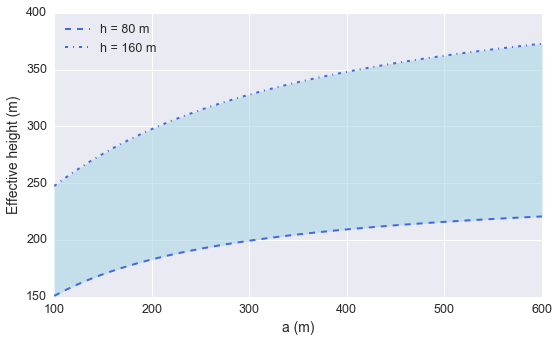

In [91]:
# Effective height as a function of hemispherical mountain base radius/height
veca = np.linspace(100, 600, 60)
efh1 = np.asarray([effective_height(80, ai) for ai in veca])
efh2 = np.asarray([effective_height(160, ai) for ai in veca])
fig, ax = plt.subplots(figsize=(8, 5))
ax.plot(veca, efh1, c='royalblue', ls='--', lw=2, label='h = 80 m')
ax.plot(veca, efh2, c='royalblue', ls='-.', lw=2, label='h = 160 m')
ax.fill_between(veca, efh1, efh2, interpolate=True, color='lightblue', alpha=0.6)
ax.legend(loc='upper left')
ax.set_xlabel('a (m)')
ax.set_ylabel('Effective height (m)')
plt.tight_layout()
plt.show()

In [92]:
# Great circle distance between points
def distance(lon_wt, lat_wt, lon_rad, lat_rad):
    # Compute a great circle distance between two points on the globe
    distance = 2.*np.arcsin(np.sqrt((np.sin((lat_wt-lat_rad)/2.))**2 +
                                    np.cos(lat_wt)*np.cos(lat_rad) *
                                    (np.sin((lon_wt-lon_rad)/2.))**2))
    # Convert distance to nautical miles
    distance_nm = ((180.*60.)/np.pi) * distance
    distance_m = distance_nm * 1852.  # convert distance to meters
    return distance_m

# Angle (true course) between points
def angle(lon_wt, lat_wt, lon_rad, lat_rad):
    tc1 = np.mod(np.arctan2(np.sin(lon_wt-lon_rad)*np.cos(lat_rad),
                 np.cos(lat_wt)*np.sin(lat_rad)-np.sin(lat_wt) *
                 np.cos(lat_rad)*np.cos(lon_wt-lon_rad)), 2*np.pi)
    return tc1

# Wind farm lightning incidence using "attractive area" concept
# Lightning incidence to WT14 in Wind farm 4
wdf = li.groupby('type').get_group(1)  # CG lightning
lons_cg = wdf['lon']
lats_cg = wdf['lat']
amps_cg = wdf['ampl']
wt_ampl = []
wt_dist = []
wt_angl = []
for key, value in wind_farm_4.iteritems():
    if key == 'WT14':  # replace for any other WT
        lon_wt = value[1] * np.pi/180.  # convert to radians
        lat_wt = value[0] * np.pi/180.  # convert to radians
        for lon, lat, ampl in zip(lons_cg, lats_cg, amps_cg):
            lon_rad = lon * np.pi/180.  # convert to radians
            lat_rad = lat * np.pi/180.  # convert to radians
            # Compute a great circle distance between two points on the globe
            distance_m = distance(lon_wt, lat_wt, lon_rad, lat_rad)
            # True course (angle) between two points on the globe
            tc1 = angle(lon_wt, lat_wt, lon_rad, lat_rad)
            if distance_m <= wt_radius:
                wt_ampl.append(ampl)
                wt_dist.append(distance_m)
                wt_angl.append(tc1)

# Convert lists to Numpy arrays
wt_ampl = np.asarray(wt_ampl)
wt_dist = np.asarray(wt_dist)
wt_angl = np.asarray(wt_angl)

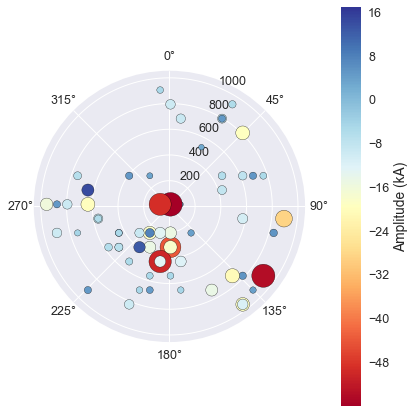

In [93]:
# Polar chart with a scatter plot
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection='polar')
theta = -wt_angl
ax.set_theta_offset(np.pi/2)  # set zero to North
ax.set_theta_direction(-1)  # clockwise direction
cs = ax.scatter(theta, wt_dist, c=wt_ampl, s=abs(wt_ampl)*10, cmap=plt.cm.get_cmap('RdYlBu'))
cbar = plt.colorbar(cs, orientation='vertical', pad=0.1)
cbar.set_label('Amplitude (kA)')
ax.set_ylim(0, wt_dist.max()+100)
plt.tight_layout()
plt.show()

Statistical distribution (using windrose) of incident lightning strikes by distance and direction:

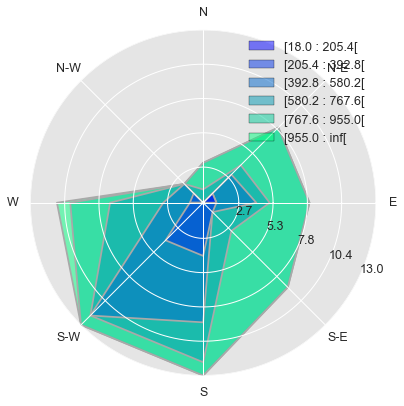

In [94]:
# windrose 1.6
from windrose import WindroseAxes

theta = -wt_angl * (180/np.pi) + 360  # convert to degrees and rotate axis
# Windrose plot http://nbviewer.ipython.org/github/scls19fr/windrose/blob/master/windrose_sample_random.ipynb
fig = plt.figure(figsize=(6, 6), facecolor='w', edgecolor='w')
rect = [0.1, 0.1, 0.8, 0.8]
axwind = WindroseAxes(fig, rect, axisbg='w')
axwind.set_axis_bgcolor('#E5E5E5')
axwind.set_radii_angle(angle=-25)
# axwind.set_rgrids(radii = [1], labels=[])  # uncomment to remove circle grid
# Number of sectors and bin distribution can be user-defined
axwind.contourf(theta, wt_dist, nsector=8, cmap=plt.cm.get_cmap('winter'), alpha=0.5)
axwind.contour(theta, wt_dist, nsector=8, colors='darkgrey')
axwind.legend('upper right')
fig.add_axes(axwind)
plt.show()

In [95]:
# Wind farm lightning incidence using "attractive area" or "striking distance" concept
# Example of Wind farm 4
wdf = li.groupby('type').get_group(1)  # CG lightning
lons_cg = wdf['lon']
lats_cg = wdf['lat']
amps_cg = wdf['ampl']
dtms_cg = wdf.index.date
no_strikes = 0
strikes_ampl = []
strikes_lons = []
strikes_lats = []
strikes_date = []
for key, value in wind_farm_4.iteritems():
    lon_wt = value[1] * np.pi/180.  # convert to radians
    lat_wt = value[0] * np.pi/180.  # convert to radians
    for lon, lat, ampl, date in zip(lons_cg, lats_cg, amps_cg, dtms_cg):
        # Skipping duplicates
        if lon in strikes_lons and lat in strikes_lats:
            pass
        lon_rad = lon * np.pi/180.  # convert to radians
        lat_rad = lat * np.pi/180.  # convert to radians
        # Compute a great circle distance between two points on the globe
        distance_m = distance(lon_wt, lat_wt, lon_rad, lat_rad)
        if distance_m <= wt_radius:
            no_strikes += 1
            strikes_ampl.append(ampl)
            strikes_lons.append(lon)
            strikes_lats.append(lat)
            strikes_date.append(date)

In [96]:
ampl1 = abs(np.array(strikes_ampl))

# Numpy histogram
nb = number_of_bins(ampl1, method='Scott')
hist, bin_edges = np.histogram(ampl1, bins=nb, density=False)
bin_edges = np.asarray(['{:.0f}'.format(x) for x in bin_edges])
df1 = pd.DataFrame({'x':bin_edges[:-1], 'y':hist})

# Vincent bar (histogram) plot
bar1 = vincent.Bar(df1, iter_idx='x', height=200, width=400)
bar1.axis_titles(x='Amplitude (kA)', y='No. strikes')
bar1.to_json('bar1.json')

In [97]:
# Folium map of lightning strikes to Wind farm 4
mapa = folium.Map(location=[43.75, 16.0], zoom_start=13)
# Lightning strikes
for lat, lon, ampl in zip(strikes_lats, strikes_lons, strikes_ampl):
    if ampl < 0:
        # Negative strikes
        mapa.circle_marker(location=[lat, lon], radius=abs(ampl),
                           popup='{:.1f} kA'.format(ampl),
                           line_color='#ff6666', fill_color='#ff6666')
    else:
        # Positive strikes
        mapa.circle_marker(location=[lat, lon], radius=ampl,
                           popup='{:.1f} kA'.format(ampl),
                           line_color='#3186cc', fill_color='#3186cc')
# Vincent marker (embeded chart in popup)
popup_vega = folium.Popup(max_width=450).add_child(folium.Vega(json.load(open('bar1.json')), width=500, height=250))
for key, val in wind_farm_4.iteritems():
    if key == 'WT7':
        folium.Marker(location=[val[0], val[1]], popup=popup_vega,
                      icon=folium.Icon(icon='cloud', color='green')).add_to(mapa)
    folium.RegularPolygonMarker(location=[val[0], val[1]], popup=key,
                        fill_color='#43d9de', number_of_sides=3, radius=10).add_to(mapa)
mapa

Click on the green marker on the map to view the embeded histogram of the wind farm incident lightning-current amplitudes distribution!

In [98]:
# Wind farm lightning incidence using "attractive radius" concept
# Example of Wind farm 4

# Effective height
eff_height = effective_height(h, a)

# Compute striking distance
def striking_distance(height, amplitude, egm='Borghetti'):
    if egm == 'Borghetti':
        R = 0.028*height*abs(amplitude) + 3.*height**0.6
    elif egm == 'Eriksson':
        R = 0.84*height**0.6*abs(amplitude)**0.74
    elif egm == 'Rizk':
        R = 1.57*height**0.45*abs(amplitude)**0.69
    elif egm == 'Cooray':
        R = 1.9*abs(amplitude)**0.9
    return R

str_ampl = []
str_lons = []
str_lats = []
for key, value in wind_farm_4.iteritems():
    lon_wt = value[1] * np.pi/180.  # convert to radians
    lat_wt = value[0] * np.pi/180.  # convert to radians
    for lon, lat, ampl in zip(lons_cg, lats_cg, amps_cg):
        # Skipping duplicates
        if lon in str_lons and lat in str_lats:
            pass
        lon_rad = lon * np.pi/180.  # convert to radians
        lat_rad = lat * np.pi/180.  # convert to radians
        # Compute a great circle distance between two points on the globe
        distance_m = distance(lon_wt, lat_wt, lon_rad, lat_rad)
        
        # Compute attractive radius
        R = striking_distance(eff_height, ampl)
        # Introduce tolerance (gps + linet)
        R += np.random.normal(100)  # 100 m tolerance
        
        if distance_m <= R:
            str_lons.append(lon)
            str_lats.append(lat)
            str_ampl.append(ampl)

In [99]:
ampl2 = abs(np.array(str_ampl))

# Numpy histogram
nb = number_of_bins(ampl2, method='Scott')
hist, bin_edges = np.histogram(ampl2, bins=nb, density=False)
bin_edges = np.asarray(['{:.0f}'.format(x) for x in bin_edges])
df2 = pd.DataFrame({'x':bin_edges[:-1], 'y':hist})

# Vincent bar (histogram) plot
bar2 = vincent.Bar(df2, iter_idx='x', height=200, width=400)
bar2.axis_titles(x='Amplitude (kA)', y='No. strikes')
bar2.to_json('bar2.json')

In [100]:
# Folium map of lightning strikes to Wind farm 4
mapa = folium.Map(location=[43.75, 16.0], zoom_start=13)
# Lightning strikes
for lat, lon, ampl in zip(str_lats, str_lons, str_ampl):
    if ampl < 0:
        # Negative strikes
        mapa.circle_marker(location=[lat, lon], radius=abs(ampl),
                           popup='{:.1f} kA'.format(ampl),
                           line_color='#ff6666', fill_color='#ff6666')
    else:
        # Positive strikes
        mapa.circle_marker(location=[lat, lon], radius=ampl,
                           popup='{:.1f} kA'.format(ampl),
                           line_color='#3186cc', fill_color='#3186cc')
# Vincent marker (embeded chart in popup)
popup_vega = folium.Popup(max_width=450).add_child(folium.Vega(json.load(open('bar2.json')), width=500, height=250))
for key, val in wind_farm_4.iteritems():
    if key == 'WT7':
        folium.Marker(location=[val[0], val[1]], popup=popup_vega,
                      icon=folium.Icon(icon='cloud', color='green')).add_to(mapa)
    folium.RegularPolygonMarker(location=[val[0], val[1]], popup=key,
                        fill_color='#43d9de', number_of_sides=3, radius=10).add_to(mapa)
mapa

Click on the green marker on the map to view the embeded histogram of the wind farm incident lightning-current amplitudes distribution!

In [101]:
# Wind turbine lightning incidence using "attractive radius" concept
# Lightning incidence to WT14 in Wind farm 4
wt_ampl2 = []
wt_dist2 = []
wt_angl2 = []
for key, value in wind_farm_4.iteritems():
    if key == 'WT14':
        lon_wt = value[1] * np.pi/180.  # convert to radians
        lat_wt = value[0] * np.pi/180.  # convert to radians
        for lon, lat, ampl in zip(lons_cg, lats_cg, amps_cg):
            lon_rad = lon * np.pi/180.  # convert to radians
            lat_rad = lat * np.pi/180.  # convert to radians
            # Compute a great circle distance between two points on the globe
            distance_m = distance(lon_wt, lat_wt, lon_rad, lat_rad)
            # True course (angle) between two points on the globe
            tc1 = angle(lon_wt, lat_wt, lon_rad, lat_rad)
            
            # Compute attractive radius
            R = striking_distance(eff_height, ampl)
            # Introduce tolerance (gps + linet)
            R += np.random.normal(100)  # 100 m tolerance            
            
            if distance_m <= R:
                wt_ampl2.append(ampl)
                wt_dist2.append(distance_m)
                wt_angl2.append(tc1)

# Convert lists to Numpy arrays
wt_ampl2 = np.asarray(wt_ampl2)
wt_dist2 = np.asarray(wt_dist2)
wt_angl2 = np.asarray(wt_angl2)

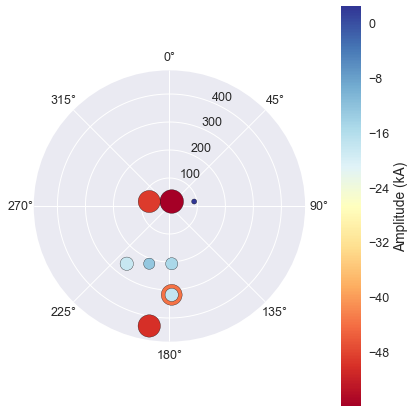

In [102]:
# Polar chart with a scatter plot
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection='polar')
theta = -wt_angl2
ax.set_theta_offset(np.pi/2)  # set zero to North
ax.set_theta_direction(-1)  # clockwise direction
cs = ax.scatter(theta, wt_dist2, c=wt_ampl2, s=abs(wt_ampl2)*10, cmap=plt.cm.get_cmap('RdYlBu'))
cbar = plt.colorbar(cs, orientation='vertical', pad=0.1)
cbar.set_label('Amplitude (kA)')
ax.set_ylim(0, wt_dist2.max()+50)
plt.tight_layout()
plt.show()

### Probability distribution of wind farm incident lightning currents

In [103]:
# Lightning-current amplitudes incident to Wind farm 4
# Obtained from applying the "attractive area" concept
amplitudes = abs(np.array(strikes_ampl))

# Fit a Log-Normal distribution
prms_inc = stats.lognorm.fit(amplitudes, floc=0)
supp_inc = np.linspace(0, np.max(amplitudes), 200)
fits_inc = stats.lognorm.pdf(supp_inc, *prms_inc)

# Kernel density estimation (KDE) of amplitudes incident to Wind farm 4
def statsmodels_univariate_kde(x, bw_type, kernel='gau', gridsize=100, cut=3):
    """
    Kernel density estimation using statsmodels library
    Variable bw_type can be string or float. In case of float 
    it is the bandwidth size, else needs to be one of the following: 
    'scott', 'silverman', 'normal reference' or 'statistics'.
    """
    kde = sm.nonparametric.KDEUnivariate(x)
    if bw_type in ['scott', 'silverman', 'normal_reference']:
        # Fit using built-in kernel bandwidth estimation
        kde.fit(kernel=kernel, bw=bw_type)
    elif bw_type == 'statistics':
        # Compute kernel bandwidth using statistics package and then fit
        bw = statistics.bandwidth(x, weight=None, kernel='gaussian')
        kde.fit(kernel=kernel, bw=bw)
    else:
        # Kernel bandwidth passed into function (computed elsewhere)
        kde.fit(kernel=kernel, bw=bw_type)
    x_support = kde_support(x, kde.bw, gridsize, cut)
    pdf = kde.evaluate(x_support)
    return x_support, pdf

# Perform KDE fit on amplitude data
x_sup, pdf = statsmodels_univariate_kde(amplitudes, 'statistics')

In [104]:
def sklearn_univariate_kde(x_data, cv_type='grid-search', kernel='gaussian', gridsize=100, cut=3, **kwargs):
    """
    Kernel Density Estimation with Scikit-learn with optimal 
    bandwidth obtained using grid search and cross-validation
    """
    # Optimal bandwidth determined using grid search with cross-validation
    if cv_type == 'grid-search':
        grid = GridSearchCV(KernelDensity(), {'bandwidth': np.linspace(0.1, 20.0, 40)}, n_jobs=2, cv=20)
    elif cv_type == 'random-search':
        grid = RandomizedSearchCV(KernelDensity(), {'bandwidth': stats.randint(0.1, 20.)}, n_jobs=2, cv=20)
    grid.fit(x_data[:, None])
    bw = grid.best_params_['bandwidth']
    # print(bw)

    # Kernel Density Estimation with Scikit-learn
    kde_skl = KernelDensity(bandwidth=bw, kernel=kernel, **kwargs)
    kde_skl.fit(x_data[:, None])
    # score_samples() returns the log-likelihood of the samples
    x_grid = kde_support(amplitudes, bw, gridsize, cut)
    log_pdf = kde_skl.score_samples(x_grid[:, None])
    pdf_func = np.exp(log_pdf)
    return x_grid, pdf_func

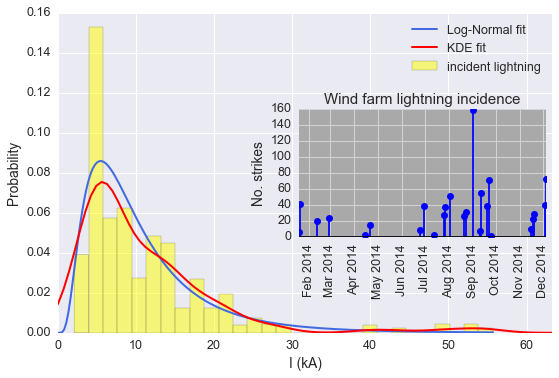

In [105]:
# Histogram and PDF of incident lightning-current amplitudes
fig, ax = plt.subplots(figsize=(8, 5.5))
ax.hist(amplitudes, bins=number_of_bins(amplitudes), normed=True,  # histtype='stepfilled',
        label='incident lightning', color='yellow', alpha=0.5)
ax.plot(supp_inc, fits_inc, c='royalblue', ls='-', lw=2, label='Log-Normal fit')
ax.plot(x_sup, pdf, c='red', ls='-', lw=2, label='KDE fit')
strikes_dict = dict(Counter(strikes_date))
axins = inset_axes(ax, width='50%', height='40%', loc=7)  # center right
axins.stem(strikes_dict.keys(), strikes_dict.values(), linefmt='b-', markerfmt='bo', basefmt='k-')
axins.set_axis_bgcolor('darkgrey')
axins.grid(color='lightgrey')
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)
axins.set_title('Wind farm lightning incidence')
axins.set_ylabel('No. strikes')
ax.legend(loc='best')
ax.set_xlabel('I (kA)')
ax.set_ylabel('Probability')
ax.set_xlim(0, x_sup.max())
plt.tight_layout()
plt.show()

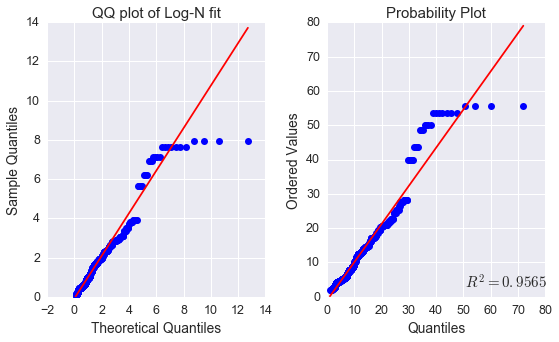

In [106]:
# QQ plot & Probplot of the Log-Normal fit
fig, ax = plt.subplots(1, 2, figsize=(8, 5))
ax[0].set_title('QQ plot of Log-N fit')
sm.graphics.qqplot(amplitudes, dist=stats.lognorm, fit=True, line='q', ax=ax[0])
stats.probplot(amplitudes, sparams=prms_inc, dist=stats.lognorm, fit=True, plot=ax[1])
plt.tight_layout()
plt.show()

In [107]:
# Perform the Kolmogorov-Smirnov test for goodness of fit
s, p_value = stats.kstest(amplitudes, 'lognorm', args=prms_inc)
print('Statistic: {:g}; p-value: {:g}'.format(s, p_value))

Statistic: 0.0877939; p-value: 5.05853e-06


It can be seen from the p-value that amplitudes distribution looks sufficiently different from the Log-normal distribution, that we can reject the hypothesis that the sample came from the Log-normal distribution at the 5% level and below.

In [108]:
# Generating random lightning-current amplitudes from 
# wind farm incident lightning with extrapolation
# Inverse transform sampling method
no_samples = 1000
# Fit a distribution to incident amplitudes data using KDE
model = sm.nonparametric.KDEUnivariate(amplitudes)
bw = statistics.bandwidth(amplitudes, weight=None, kernel='gaussian')
model.fit(kernel='gau', bw=bw, gridsize=100, cut=3)
support = np.linspace(0, amplitudes.max(), 100)
pdf = model.evaluate(support)  # PDF obtained from KDE
epsilon = 10.  # max. expected increase for extrapolation
min_ampl = min(amplitudes)
max_ampl = max(amplitudes) + epsilon
unif = np.random.uniform(min_ampl, max_ampl, size=no_samples)
# Interpolating ICDF function using cubic splines (with extrapolation)
tolerance = 1.  # for extrapolation on ICDF data
icdf_spline = interpolate.UnivariateSpline(model.support, model.icdf,
              bbox=[model.support.min()-tolerance, 
                    model.support.max()+tolerance], k=3)  # bbox for extrapolation
# Generate new random amplitudes from KDE with extrapolation
ampl_rand = icdf_spline(unif)

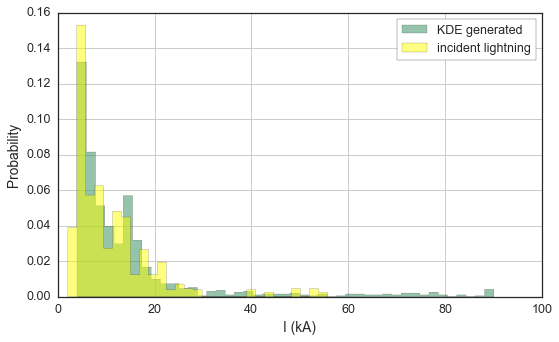

In [109]:
# Histogram of incident and generated lightning amplitudes
with sns.axes_style(style='white', rc={'font.size':16}):  # set temporary style for this figure
    fig, ax = plt.subplots(figsize=(8, 5))
    ax.hist(ampl_rand, bins=number_of_bins(ampl_rand), normed=True, histtype='stepfilled',
            label='KDE generated', color='seagreen', alpha=0.5)
    ax.hist(amplitudes, bins=number_of_bins(amplitudes), normed=True, histtype='stepfilled',
            label='incident lightning', color='yellow', alpha=0.5)
    # ax.plot(support, pdf, c='red', ls='-', lw=2, label='PDF from KDE fit')
    ax.legend(loc='upper right', frameon='fancy')
    ax.grid(True)
    ax.set_xlabel('I (kA)')
    ax.set_ylabel('Probability')
    plt.tight_layout()
    plt.show()

**Disclaimer:** This notebook is furnished "as is". The author does not provide any warranty whatsoever, whether express, implied, or statutory, including, but not limited to, any warranty of merchantability or fitness for a particular purpose or any warranty that the contents of the notebook will be error-free. In no respect shall the author incur any liability for any damages, including, but limited to, direct, indirect, special, or consequential damages arising out of, resulting from, or any way connected to the use of the notebook material, whether or not based upon warranty, contract, tort, or otherwise; whether or not injury was sustained by persons or property or otherwise; and whether or not loss was sustained from, or arose out of, the usage of the results of the notebook material.